# Initial Data Analysis
## General
### Topic

The objective of this research is to analyze performance metrics of different ML algorithms in the field of heart disease prediction using limited sample sizes and how they are influenced by varying training and validation strategies.

### Questions

1. How will the training and validation strategy of an ML algorithm impact the performance metrics?

    **Methods:** Randomly select stratified samples for varying sizes from the total data, determining the performance metrics and to average them afterwards. This process should be varied as follows:
    - Differ concrete algorithm: SVM, Bayes, KNN, Random Forest, Decision Tree, Logistic Regression.
    - Change number of selected features and feature selection methods: RFE and Sequential Feature Selection (eventually PCA, UMAP...).
    - Selecting Nested CV, K-Fold CV, Mixed CV or Train/Test Split for training/validation (feature selection, parameter tuning).
    - Changing the train-test-ratio in Train/Test Split, the number of folds in parameter selection in all validation methods and changing the number of folds in validation and feature selection in all methods apart from Train/Test Split.
2. How do performance metrics compare to one another when sample size varies?

    **Methods:** Change sample size and performance metric, do the training and in the end validate a given ML model on the test set. Performance metrics chosen: 'accuracy', 'balanced_accuracy', 'top_k_accuracy', 'average_precision', 'neg_brier_score' (more details at [Metrics and scoring](https://scikit-learn.org/stable/modules/model_evaluation.html))

3. How do subgroup structures impact performance metrics?

    **Methods:** Reduce samples to a certain group. Groups chosen: sex (male or female), age groups (young: age under 50, middle: 50 =< age < 65, elder: age >= 65). A combination of groups is also considered.

## Dataset

### Source

I am planning to use the [Heart Disease Data Set](https://archive.ics.uci.edu/ml/datasets/Heart+Disease) by the UCI Center for Machine Learning and Intelligent Systems. It consists of four single datasets from the 1980s that have been published by the
1.	Hungarian Institute of Cardiology. Budapest: Andras Janosi, M.D.
2.	University Hospital, Zurich, Switzerland: William Steinbrunn, M.D.
3.	University Hospital, Basel, Switzerland: Matthias Pfisterer, M.D.
4.	V.A. Medical Center, Long Beach and Cleveland Clinic Foundation: Robert Detrano, M.D., Ph.D.

In the following I will mainly analyse the combined dataset, albeit commenting on the structure of the single datasets whenever relevant.

### Loading the Dataset

Before we describe our data, we need to load the data.

In [1]:
import os
from math import ceil
import numpy as np
import pandas as pd
import jupyter
import glob
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import RFE, SequentialFeatureSelector
from sklearn.impute import KNNImputer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, balanced_accuracy_score, top_k_accuracy_score, average_precision_score, \
    brier_score_loss
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold, cross_validate
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from statistics import mean, median
from scipy import stats
from matplotlib.colors import LogNorm

In [2]:
column_names = ['age', 'sex', 'cp', 'trestbps', 'chol', 'fbs', 'restecg', 'thalach', 'exang', 'oldpeak', 'slope', 'ca', 'thal', 'target']
data_path = os.path.join(os.getcwd(), "data/")

# cleveland -- 0, hungarian -- 1, switzerland -- 2, va -- 3
     # 1. Cleveland Clinic Foundation (processed.cleveland.data)
     # 2. Hungarian Institute of Cardiology, Budapest (reprocessed.hungarian.data)
     # 3. V.A. Medical Center, Long Beach, CA (processed.va.data)
     # 4. University Hospital, Zurich, Switzerland (processed.switzerland.data)


# In the raw data the '?' symbol is used for missing data (for data sets 0,2,3). Let us replace those values by np.NaN.
cleveland_data = pd.read_csv(os.path.join(data_path, "processed.cleveland.data"), names=column_names, na_values='?')
cleveland_data['location'] = 0

# This is a reprocessed data set. In the original reprocessed version a 9 was written instead of a -9 for nan in one sample, but this was directly edited in the file instead of here.
hungarian_data = pd.read_csv(os.path.join(data_path, "reprocessed.hungarian.data"), na_values='-9', names=column_names, delimiter=' ')
hungarian_data['location'] = 1

switzerland_data = pd.read_csv(os.path.join(data_path, "processed.switzerland.data"), names=column_names, na_values='?')
switzerland_data['location'] = 2

va_data = pd.read_csv(os.path.join(data_path, "processed.va.data"), names=column_names, na_values='?')
va_data['location'] = 3

data = pd.concat([cleveland_data, hungarian_data, switzerland_data, va_data], axis=0, ignore_index=True)

In [3]:
data['age_group'] = data['age'].apply(lambda x: 0 if x < 50 else 1 if 50 <= x < 65 else 2)
data = data.astype(float)

# shifting range of values
data['thal'].replace({3.0: 0.0, 6.0: 1.0, 7.0: 2.0}, inplace=True)
data = data[['age', 'age_group', 'sex', 'cp', 'trestbps', 'chol', 'fbs', 'restecg', 'thalach', 'exang', 'oldpeak', 'slope', 'ca', 'thal', 'location', 'target']]

### Overview

Let us quickly inspect the data.

In [4]:
data

,age,age_group,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,location,target
0,63.0,1.0,1.0,1.0,145.0,233.0,1.0,2.0,150.0,0.0,2.3,3.0,0.0,1.0,0.0,0.0
1,67.0,2.0,1.0,4.0,160.0,286.0,0.0,2.0,108.0,1.0,1.5,2.0,3.0,0.0,0.0,2.0
2,67.0,2.0,1.0,4.0,120.0,229.0,0.0,2.0,129.0,1.0,2.6,2.0,2.0,2.0,0.0,1.0
3,37.0,0.0,1.0,3.0,130.0,250.0,0.0,0.0,187.0,0.0,3.5,3.0,0.0,0.0,0.0,0.0
4,41.0,0.0,0.0,2.0,130.0,204.0,0.0,2.0,172.0,0.0,1.4,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
915,54.0,1.0,0.0,4.0,127.0,333.0,1.0,1.0,154.0,0.0,0.0,NaN,NaN,NaN,3.0,1.0
916,62.0,1.0,1.0,1.0,NaN,139.0,0.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,3.0,0.0
917,55.0,1.0,1.0,4.0,122.0,223.0,1.0,1.0,100.0,0.0,0.0,NaN,NaN,1.0,3.0,2.0
918,58.0,1.0,1.0,4.0,NaN,385.0,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,3.0,0.0


In [5]:
len(data)

920

#### Columns

The datasets share the same 14 columns:

1. age: age in years
2. age_group:
        -- 0 = (age < 50)
        -- 1 = (50 <= age < 65)
        -- 2 = (65 <= age)
3. sex: sex (1 = male; 0 = female)
4. cp: chest pain type
        -- Value 1: typical angina
        -- Value 2: atypical angina
        -- Value 3: non-anginal pain
        -- Value 4: asymptomatic
5. trestbps: resting blood pressure (in mm Hg on admission to the hospital)
6. chol: serum cholestoral in mg/dl
7. fbs: fasting blood sugar > 120 mg/dl  (1 = true; 0 = false)
8. restecg: resting electrocardiographic results
        -- Value 0: normal
        -- Value 1: having ST-T wave abnormality (T wave inversions and/or ST
                    elevation or depression of > 0.05 mV)
        -- Value 2: showing probable or definite left ventricular hypertrophy
                    by Estes' criteria
9. thalach: maximum heart rate achieved
10. exang: exercise induced angina (1 = yes; 0 = no)
11. oldpeak: ST depression induced by exercise relative to rest
12. slope: the slope of the peak exercise ST segment
        -- Value 1: upsloping
        -- Value 2: flat
        -- Value 3: downsloping
13. ca: number of major vessels (0-3) colored by flourosopy
14. thal: A blood disorder called thalassemia (0 = normal; 1 = fixed defect; 2 = reversable defect)
15. location: location of origin (cleveland = 0, hungarian = 1, switzerland = 2, va = 3)
16. target: diagnosis of heart disease (angiographic disease status)
        -- Value 0: < 50% diameter narrowing
        -- Value 1, 2, 3, 4: > 50% diameter narrowing

Only 'chol', 'thalach' and 'oldpeak' are continuous, whereas the other features are multiclass/binary. 'Thal' was adjusted from values in (3,6,7) to (0,1,2). age_group and location are manually added.

#### Samples

In total our data set consists of 920 samples. The most data comes from the cleveland and hungarian data set.

In [6]:
data.groupby(['location']).size()

location
0.0    303
1.0    294
2.0    123
3.0    200
dtype: int64

### Initial Plotting

Before discussing the actual missing values, we would like to do some plotting in advance to spot other defects in the data.

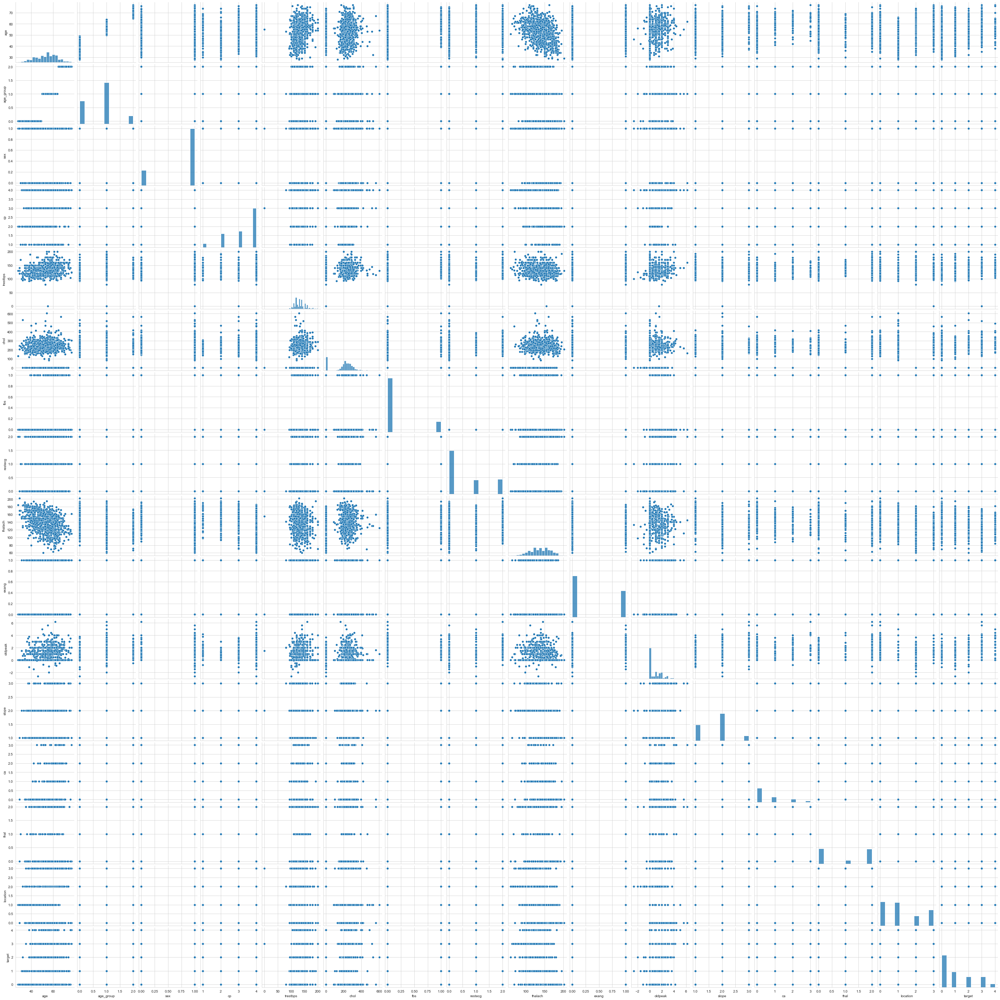

In [7]:
sns.pairplot(data)
plt.show()

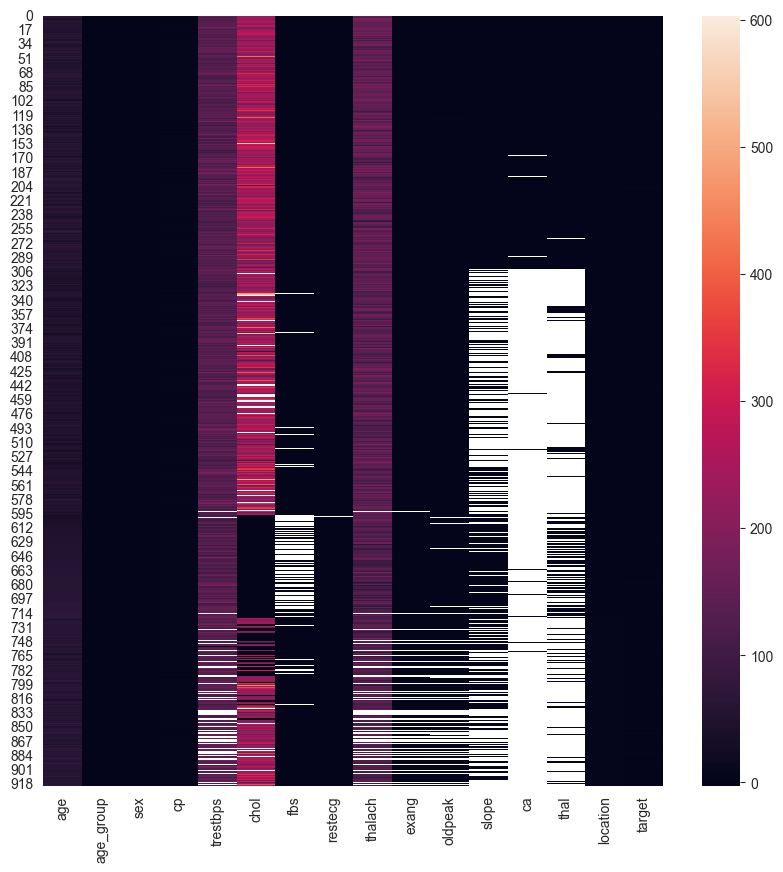

In [8]:
plt.figure(figsize=(10,10))
sns.heatmap(data)
plt.show()

One can see in the first plot that there are 0-values in the columns 'chol' and 'trestbps'. Thus, we will consider those values in the following as missing values. One can see in the second plot that there are considerable missing values in the columns 'slope', 'ca' and 'thal' which will also be discussed in the following.

In [9]:
# replace 0-values in 'chol' and 'trestbps' with np.NaN since they are invalid/missing
data.replace({'chol': 0, 'trestbps': 0}, value=np.NaN, inplace=True)

### Duplicates

Let us check for possible duplicates.

In [10]:
data[data.duplicated(keep=False)]

,age,age_group,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,location,target
393,49.0,0.0,0.0,2.0,110.0,NaN,0.0,0.0,160.0,0.0,0.0,NaN,NaN,NaN,1.0,0.0
466,49.0,0.0,0.0,2.0,110.0,NaN,0.0,0.0,160.0,0.0,0.0,NaN,NaN,NaN,1.0,0.0
859,58.0,1.0,1.0,3.0,150.0,219.0,0.0,1.0,118.0,1.0,0.0,NaN,NaN,NaN,3.0,2.0
907,58.0,1.0,1.0,3.0,150.0,219.0,0.0,1.0,118.0,1.0,0.0,NaN,NaN,NaN,3.0,2.0


In [11]:
data.drop_duplicates(inplace=True, ignore_index=True)

This leaves us with 918 samples.

### Missing values
Let us check how many columns are affected by missing values.

In [12]:
# data[(data.isna()).any(1) | (data['chol'] == 0) | (data['trestbps'] == 0)]
# data.isna().sum() / len(data) * 100


# nan_data = data[data.apply(lambda x: (x['chol'] == 0 or x['trestbps'] == 0 or x.isna().any(0)), axis=1)]
nan_data = data[data.isna().any(1)]
nan_data

,age,age_group,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,location,target
87,53.0,1.0,0.0,3.0,128.0,216.0,0.0,2.0,115.0,0.0,0.0,1.0,0.0,NaN,0.0,0.0
166,52.0,1.0,1.0,3.0,138.0,223.0,0.0,0.0,169.0,0.0,0.0,1.0,NaN,0.0,0.0,0.0
192,43.0,0.0,1.0,4.0,132.0,247.0,1.0,2.0,143.0,1.0,0.1,2.0,NaN,2.0,0.0,1.0
266,52.0,1.0,1.0,4.0,128.0,204.0,1.0,0.0,156.0,1.0,1.0,2.0,0.0,NaN,0.0,2.0
287,58.0,1.0,1.0,2.0,125.0,220.0,0.0,0.0,144.0,0.0,0.4,2.0,NaN,2.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
913,54.0,1.0,0.0,4.0,127.0,333.0,1.0,1.0,154.0,0.0,0.0,NaN,NaN,NaN,3.0,1.0
914,62.0,1.0,1.0,1.0,NaN,139.0,0.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,3.0,0.0
915,55.0,1.0,1.0,4.0,122.0,223.0,1.0,1.0,100.0,0.0,0.0,NaN,NaN,1.0,3.0,2.0
916,58.0,1.0,1.0,4.0,NaN,385.0,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,3.0,0.0


In [13]:
# missing_total = data.apply(lambda x: ((x.isna().sum() if (x.name != 'chol' and x.name != 'trestbps') else (x.isna() | x.apply(lambda y: y == 0)).sum()) / len(x) * 100))
missing_total = data.isna().sum() / len(data) * 100
missing_total

age           0.000000
age_group     0.000000
sex           0.000000
cp            0.000000
trestbps      6.535948
chol         21.895425
fbs           9.803922
restecg       0.217865
thalach       5.991285
exang         5.991285
oldpeak       6.753813
slope        33.442266
ca           66.339869
thal         52.723312
location      0.000000
target        0.000000
dtype: float64

One can see that especially 'ca' and 'thal' have many missing values with an absence rate of over 66% and 52% respectively. Let us check the different data sets individually, which also make up our first subgroup.

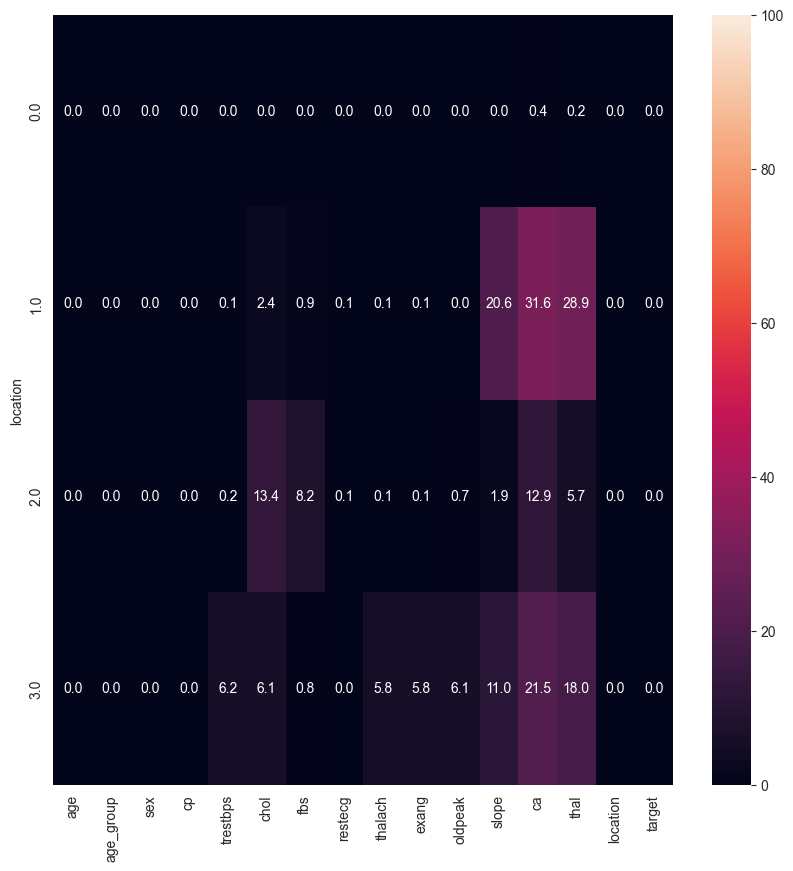

In [14]:
# missing = data.groupby('location').apply(lambda x: x.isna().sum() / len(x) *100)
# missing_grouped = data.groupby('location').apply(lambda x: x.apply(lambda y: ((y.isna().sum() if (y.name != 'chol' and y.name != 'trestbps') else (y.isna() | y.apply(lambda z: z == 0)).sum()) / len(y) * 100)))

# the percentage of missing values for a certain group in comparison to the total size of the data set
missing_subgroup_location = data.groupby('location').apply(lambda x: x.isna().sum() / len(data) * 100)
plt.figure(figsize=(10, 10))
sns.heatmap(data=missing_subgroup_location, vmin=0, vmax=100, annot=True, fmt='.1f')
plt.show()

In [15]:
# missing_subgroup_location

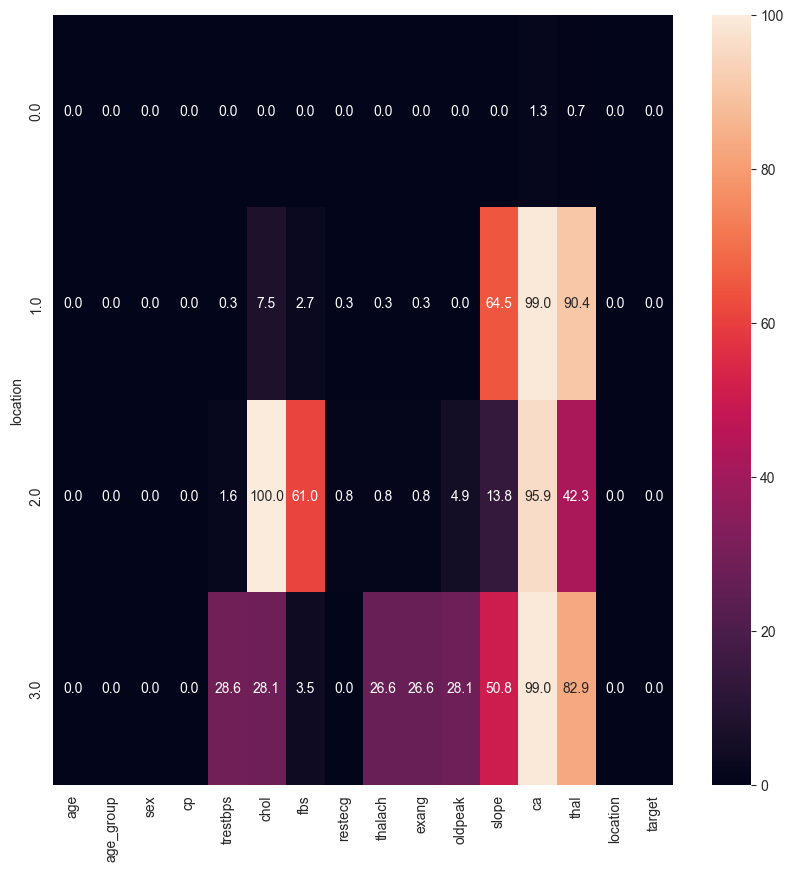

In [16]:
# the percentage of missing values for a certain group in comparison to the total size of the group itself
missing_subgroup_location_ingroup = data.groupby('location').apply(lambda x: x.isna().sum() / len(x) * 100)
plt.figure(figsize=(10, 10))
sns.heatmap(data=missing_subgroup_location_ingroup, vmin=0, vmax=100 , annot=True, fmt='.1f')
plt.show()

In [17]:
# missing_subgroup_location_ingroup

One can easily see, that the datasets of Hungary, Switzerland and VA contribute to a high absence of 'ca' and 'thal'. The Hungarian data set and the one from va also have a high absence of the 'slope' feature, 64% and 51% respectively. The Switzerland data set has a 60% absence of the 'fbs' and 'chol' feature. But compared to the total size of the samples it is fairly low.

### Other Subgroups

Since we would like to apply ML to the subgroups 'sex' and 'age' as well, let us take a look at those as well.

#### Sex

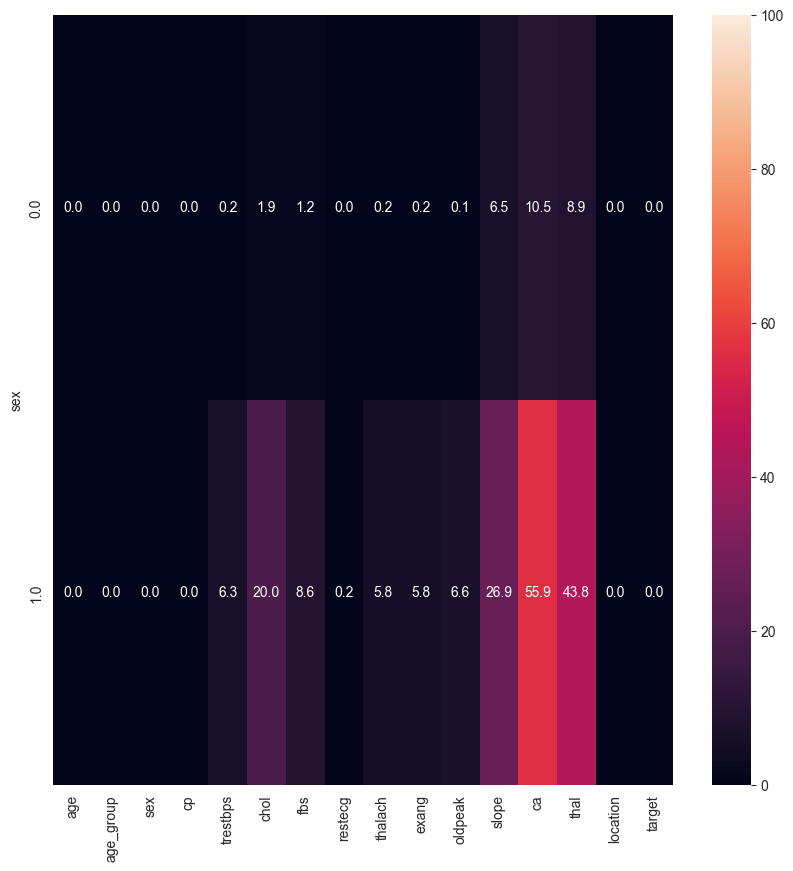

In [18]:
missing_subgroup_sex = data.groupby('sex').apply(lambda x: x.isna().sum() / len(data) * 100)
plt.figure(figsize=(10, 10))
sns.heatmap(data=missing_subgroup_sex, vmin=0, vmax=100, annot=True, fmt='.1f')
plt.show()

In [19]:
# missing_subgroup_sex

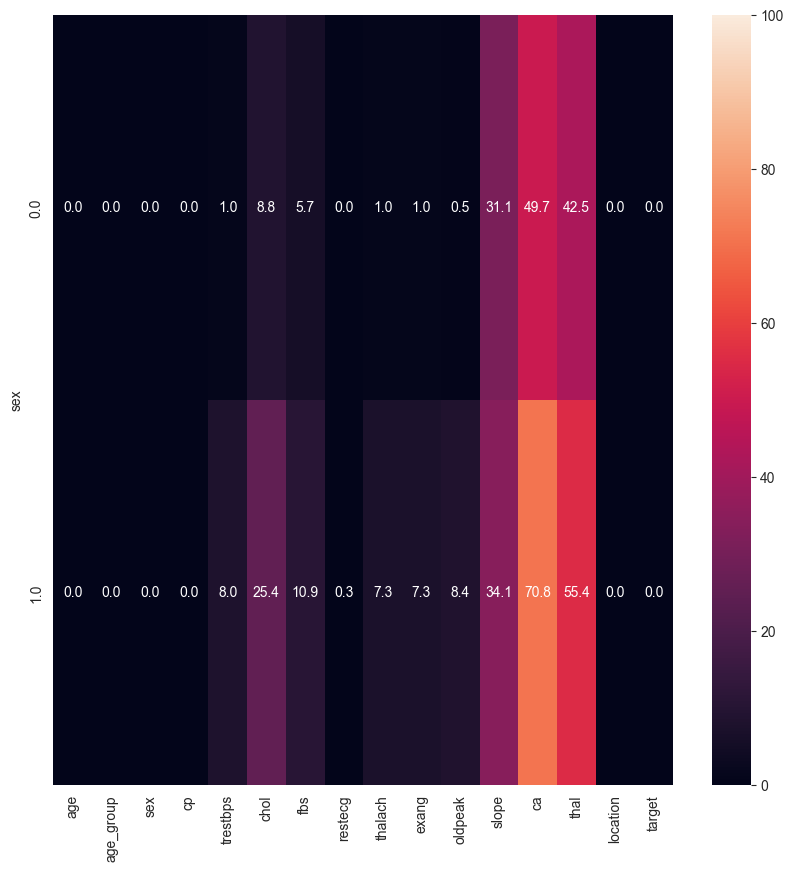

In [20]:
missing_subgroup_sex_ingroup = data.groupby('sex').apply(lambda x: x.isna().sum() / len(x) * 100)
plt.figure(figsize=(10, 10))
sns.heatmap(data=missing_subgroup_sex_ingroup, vmin=0, vmax=100, annot=True, fmt='.1f')
plt.show()

In [21]:
# missing_subgroup_sex_ingroup

One can see, that both male and female have high absence rates in the range of 30% - 70% in the columns 'slope', 'ca' and 'thal' in their group, but male tend to have higher absence rates than female. Also male have an absence rate of over 25% in the 'chol' column.

#### Age groups

Let us take a look at the age groups. For that matter we will split our data into three groups:
1. 0 = (age < 50)
2. 1 = (50 <= age < 65)
3. 2 = (65 <= age)

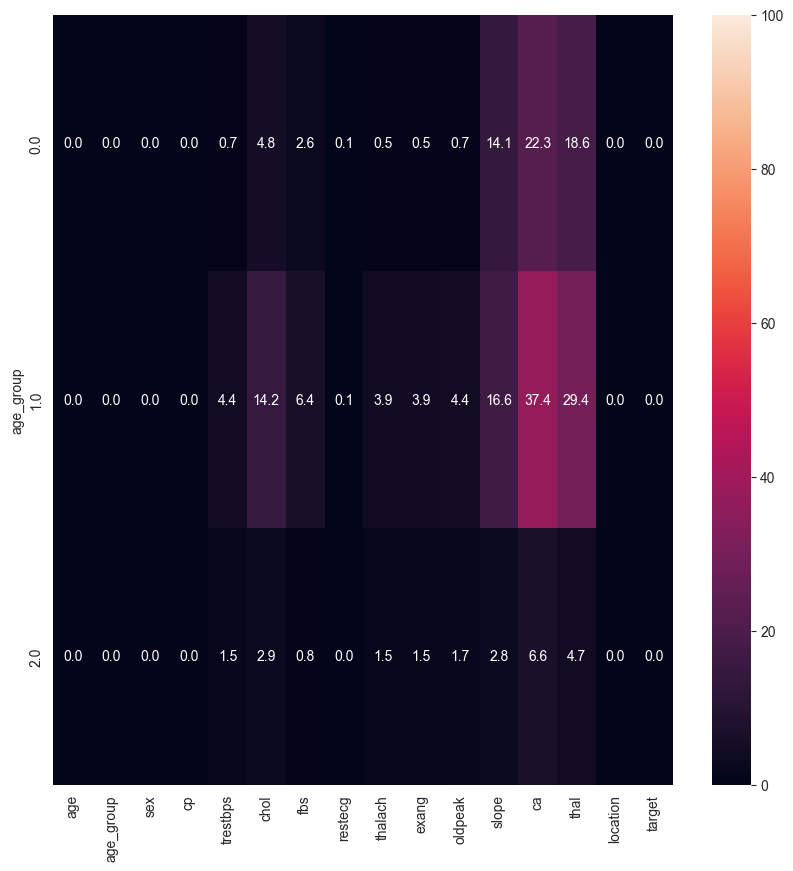

In [22]:
# missing_subgroup_age =data.groupby(data['age'].apply(lambda x: 0 if x < 50 else 1 if 50 <= x < 65 else 2)).apply(lambda x: x.isna().sum() / len(data) * 100)
missing_subgroup_age = data.groupby('age_group').apply(lambda x: x.isna().sum() / len(data) * 100)
plt.figure(figsize=(10, 10))
sns.heatmap(data=missing_subgroup_age, vmin=0, vmax=100, annot=True, fmt='.1f')
plt.show()

In [23]:
# missing_subgroup_age

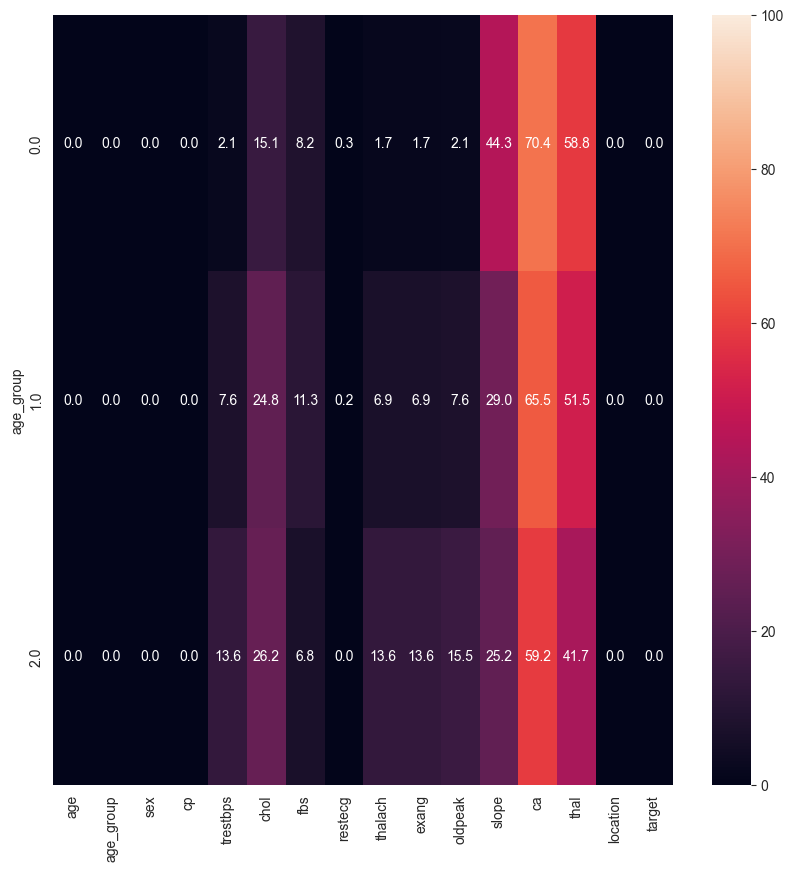

In [24]:
# data_with_age_group = data
# data_with_age_group['age_group'] = data_with_age_group['age'].apply(lambda x: 0 if x < 50 else 1 if 50 <= x < 65 else 2)
# data_with_age_group

# missing_subgroup_age_ingroup =data.groupby(data['age'].apply(lambda x: 0 if x < 50 else 1 if 50 <= x < 65 else 2)).apply(lambda x: x.isna().sum() / len(x) * 100)
missing_subgroup_age_ingroup = data.groupby('age_group').apply(lambda x: x.isna().sum() / len(x) * 100)
plt.figure(figsize=(10, 10))
sns.heatmap(data=missing_subgroup_age_ingroup, vmin=0, vmax=100, annot=True, fmt='.1f')
plt.show()

In [25]:
# missing_subgroup_age_ingroup

One can see, that all age groups have high absence rates in the range of 25% - 70% in the columns 'slope', 'ca' and 'thal', but the younger the age group the higher the absence rates for those features. There are also significant absence rates between 2% - 26% in the columns 'trestbps', 'chol' and 'fbs', which increase for older age groups.



#### Consequences

1. Replacing missing values will lead to continuous distributions.
2. Distributions in 'ca' and 'thal' will be heavily determined by the Cleveland data set and thus might not be a significant feature for the Switzerland, VA and Hungarian data set.
3. Any assumptions about the type of distributions in 'ca' and 'thal' are not very precise, since data is imputed not actually measured.

#### Solutions

There are multiple options to deal with missing values. One is to remove all rows, which have a NaN value in any column. But this will only leave us with

In [26]:
non_nan_data = data.dropna()
# non_nan_data = data[data.apply(lambda x: (x['chol'] != 0 and x['trestbps'] != 0 and ~x.isna().any(0)), axis=1)]
non_nan_data.groupby('location').size()

location
0.0    297
1.0      1
3.0      1
dtype: int64

While this might be a safe option it will drastically reduce our samples to mainly ones from the cleveland data set. Thus, imputation might be the way to go. While imputation could be done by using the mean oder median, the most plausible option would be to use knn imputation as it retains relative positions of samples. We need to keep in mind, that when using any imputation one data set from one region might adopt values from another region without considered biological differences between patients due to different living circumstances.

In [27]:
imputer = KNNImputer(n_neighbors=5)
data_imputed = pd.DataFrame(imputer.fit_transform(data), columns=data.columns)
# recast data
data_imputed = data_imputed.astype({'age': int, 'age_group': int, 'sex': int, 'cp': int, 'trestbps': float, 'chol': float, 'fbs': float, 'restecg': float, 'thalach': float, 'exang': float, 'oldpeak': float, 'slope': float, 'ca': float, 'thal': float, 'location': int, 'target': int})
data_imputed

,age,age_group,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,location,target
0,63,1,1,1,145.0,233.0,1.0,2.0,150.0,0.0,2.30,3.0,0.0,1.0,0,0
1,67,2,1,4,160.0,286.0,0.0,2.0,108.0,1.0,1.50,2.0,3.0,0.0,0,2
2,67,2,1,4,120.0,229.0,0.0,2.0,129.0,1.0,2.60,2.0,2.0,2.0,0,1
3,37,0,1,3,130.0,250.0,0.0,0.0,187.0,0.0,3.50,3.0,0.0,0.0,0,0
4,41,0,0,2,130.0,204.0,0.0,2.0,172.0,0.0,1.40,1.0,0.0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
913,54,1,0,4,127.0,333.0,1.0,1.0,154.0,0.0,0.00,1.8,0.4,1.4,3,1
914,62,1,1,1,139.2,139.0,0.0,1.0,139.4,0.2,1.04,2.2,1.0,1.2,3,0
915,55,1,1,4,122.0,223.0,1.0,1.0,100.0,0.0,0.00,2.2,0.6,1.0,3,2
916,58,1,1,4,150.0,385.0,1.0,2.0,122.0,1.0,0.80,2.0,0.8,1.6,3,0


Nonetheless, it is recognizable that former binary values have turning into continuous values. Let us take a look at 'fbs':

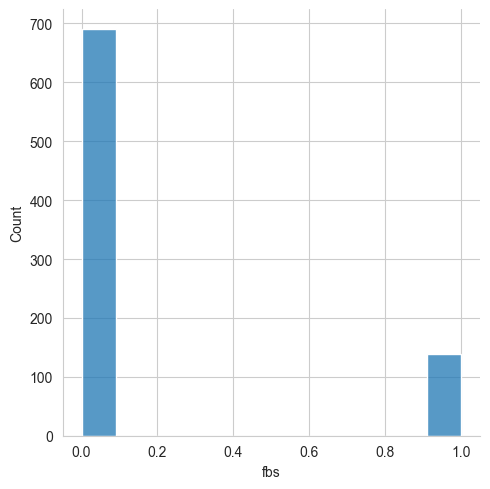

In [28]:
sns.displot(data, x='fbs')
plt.show()

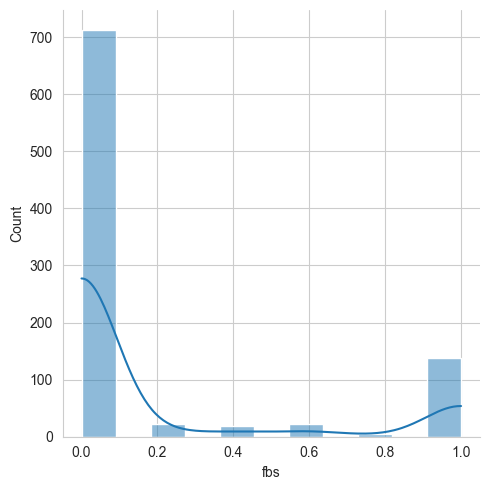

In [29]:
sns.displot(data_imputed, x='fbs', kde=True)
plt.show()

In [30]:
data_imputed

,age,age_group,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,location,target
0,63,1,1,1,145.0,233.0,1.0,2.0,150.0,0.0,2.30,3.0,0.0,1.0,0,0
1,67,2,1,4,160.0,286.0,0.0,2.0,108.0,1.0,1.50,2.0,3.0,0.0,0,2
2,67,2,1,4,120.0,229.0,0.0,2.0,129.0,1.0,2.60,2.0,2.0,2.0,0,1
3,37,0,1,3,130.0,250.0,0.0,0.0,187.0,0.0,3.50,3.0,0.0,0.0,0,0
4,41,0,0,2,130.0,204.0,0.0,2.0,172.0,0.0,1.40,1.0,0.0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
913,54,1,0,4,127.0,333.0,1.0,1.0,154.0,0.0,0.00,1.8,0.4,1.4,3,1
914,62,1,1,1,139.2,139.0,0.0,1.0,139.4,0.2,1.04,2.2,1.0,1.2,3,0
915,55,1,1,4,122.0,223.0,1.0,1.0,100.0,0.0,0.00,2.2,0.6,1.0,3,2
916,58,1,1,4,150.0,385.0,1.0,2.0,122.0,1.0,0.80,2.0,0.8,1.6,3,0


In [31]:
# subgroups, .reset_index() could be done, dropping optional? .drop(['location'], axis= 1)
# location
cleveland_data_imputed = data_imputed[data_imputed['location'] == 0]
hungarian_data_imputed = data_imputed[data_imputed['location'] == 1]
switzerland_data_imputed = data_imputed[data_imputed['location'] == 2]
va_data_imputed = data_imputed[data_imputed['location'] == 3]

# sex
female_data_imputed = data_imputed[data_imputed['sex'] == 0]
male_data_imputed = data_imputed[data_imputed['sex'] == 1]

# age_group
young_data_imputed = data_imputed[data_imputed['age_group'] == 0]
middle_data_imputed = data_imputed[data_imputed['age_group'] == 1]
elder_data_imputed = data_imputed[data_imputed['age_group'] == 2]

## Visualization

Puh...

After this long process, let us take a look at the data more in detail. We will divide this section, into a general visualization of the entire data set and then looking at the individual subgroups.

### General

In [32]:
data_imputed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 918 entries, 0 to 917
Data columns (total 16 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   age        918 non-null    int32  
 1   age_group  918 non-null    int32  
 2   sex        918 non-null    int32  
 3   cp         918 non-null    int32  
 4   trestbps   918 non-null    float64
 5   chol       918 non-null    float64
 6   fbs        918 non-null    float64
 7   restecg    918 non-null    float64
 8   thalach    918 non-null    float64
 9   exang      918 non-null    float64
 10  oldpeak    918 non-null    float64
 11  slope      918 non-null    float64
 12  ca         918 non-null    float64
 13  thal       918 non-null    float64
 14  location   918 non-null    int32  
 15  target     918 non-null    int32  
dtypes: float64(10), int32(6)
memory usage: 93.4 KB


In [33]:
data_imputed.describe()

,age,age_group,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,location,target
count,918.000000,918.000000,918.000000,918.000000,918.000000,918.000000,918.000000,918.000000,918.000000,918.000000,918.000000,918.000000,918.000000,918.000000,918.000000,918.000000
mean,53.510893,0.795207,0.789760,3.251634,132.347059,246.584967,0.182135,0.604793,136.791285,0.394118,0.889651,1.750545,0.758606,1.191939,1.237473,1.133987
std,9.432617,0.622636,0.407701,0.931031,18.082548,52.953408,0.365626,0.805691,25.508216,0.477918,1.062613,0.543380,0.668098,0.751284,1.129669,1.259433
min,28.000000,0.000000,0.000000,1.000000,80.000000,85.000000,0.000000,0.000000,60.000000,0.000000,-2.600000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,47.000000,0.000000,1.000000,3.000000,120.000000,215.000000,0.000000,0.000000,120.000000,0.000000,0.000000,1.200000,0.050000,0.600000,0.000000,0.000000
50%,54.000000,1.000000,1.000000,4.000000,130.000000,240.000000,0.000000,0.000000,138.000000,0.000000,0.600000,2.000000,0.800000,1.400000,1.000000,1.000000
75%,60.000000,1.000000,1.000000,4.000000,140.000000,273.000000,0.000000,1.000000,156.000000,1.000000,1.500000,2.000000,1.000000,2.000000,2.000000,2.000000
max,77.000000,2.000000,1.000000,4.000000,200.000000,603.000000,1.000000,2.000000,202.000000,1.000000,6.200000,3.000000,3.000000,2.000000,3.000000,4.000000


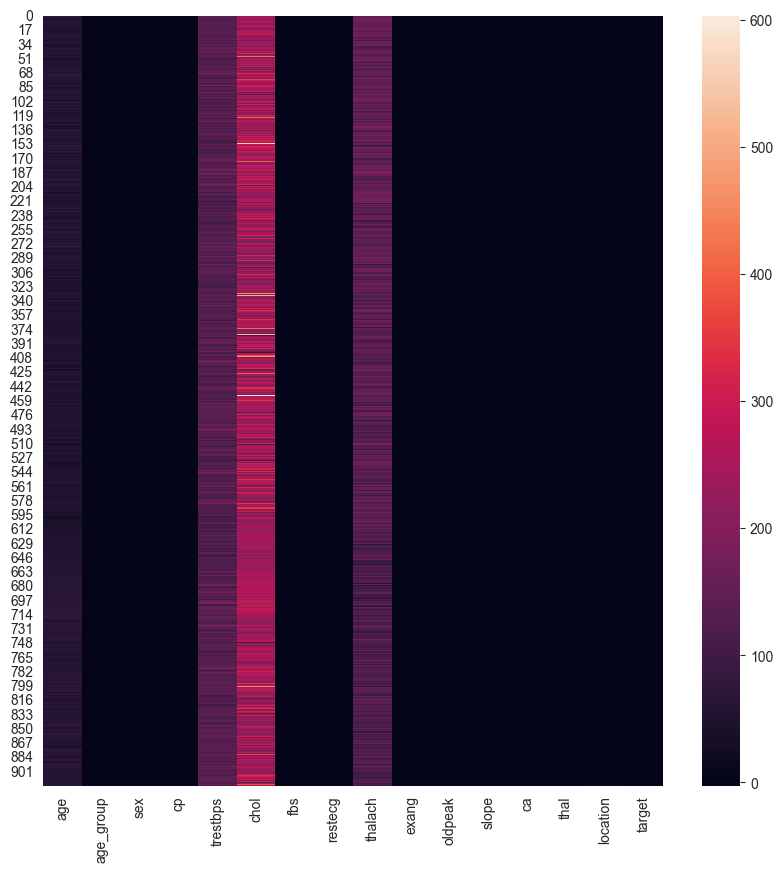

In [34]:
plt.figure(figsize=(10,10))
sns.heatmap(data_imputed, annot=False)
plt.show()

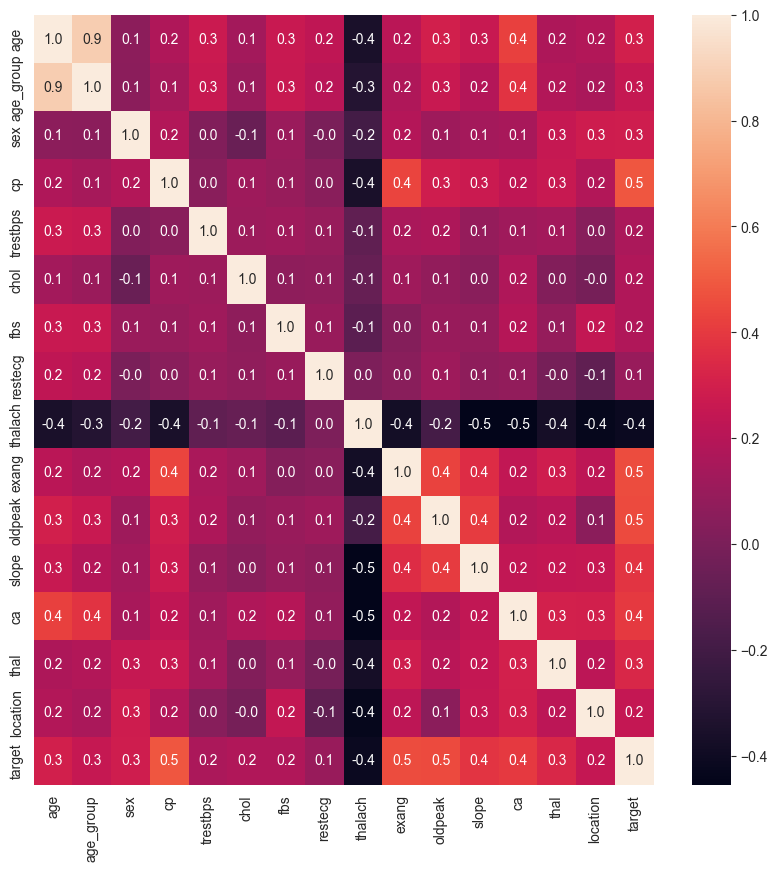

In [35]:
plt.figure(figsize=(10,10))
sns.heatmap(data_imputed.corr(method='spearman'), annot=True, fmt='.1f')
plt.show()

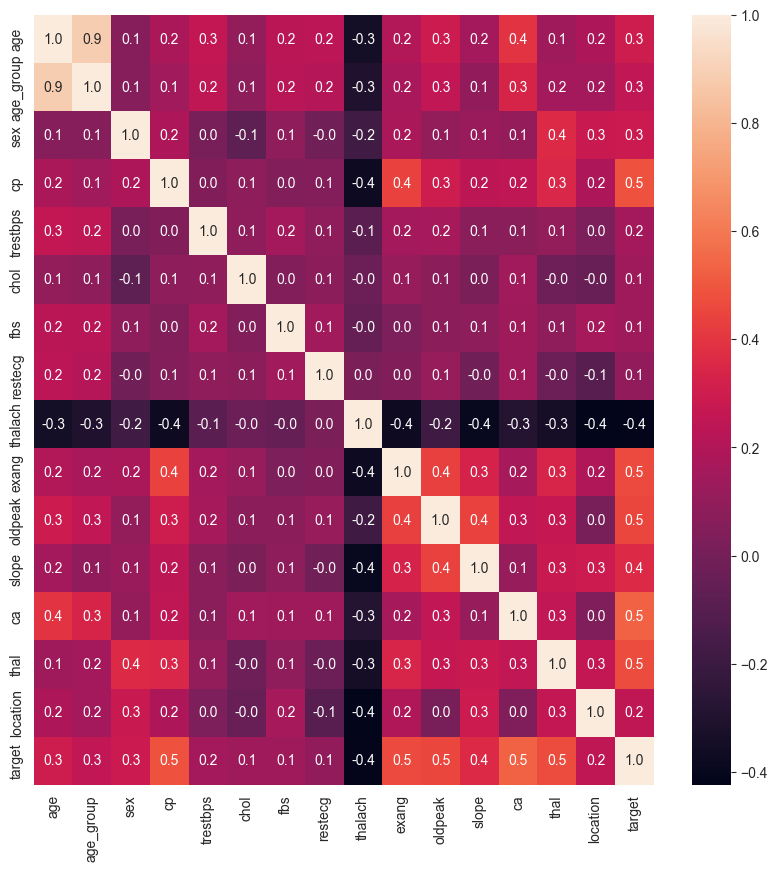

In [36]:
plt.figure(figsize=(10,10))
sns.heatmap(data.corr(method='spearman'), annot=True, fmt='.1f')
plt.show()

In [37]:
# this one ist just for later use in code
data_imputed[data_imputed['location'] == 0].groupby('age_group').size()

age_group
0     87
1    175
2     41
dtype: int64

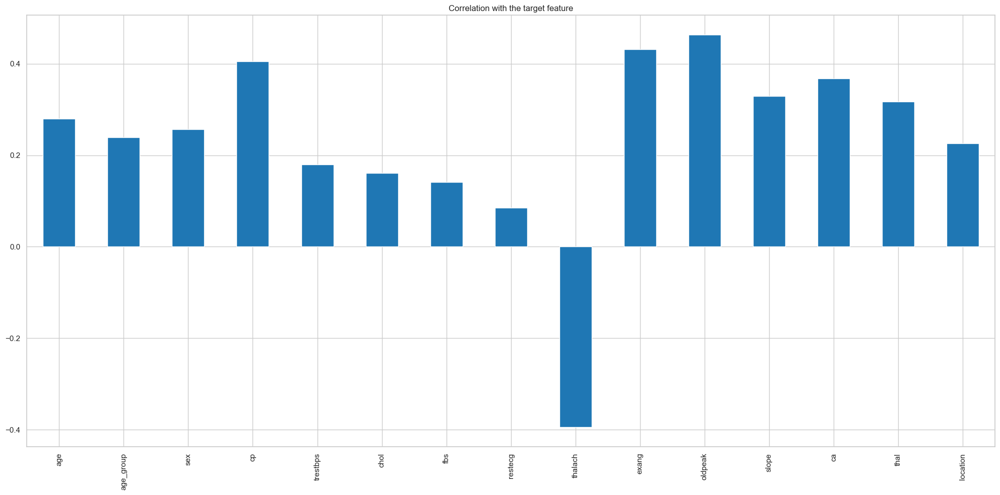

In [38]:
sns.set_context('notebook', font_scale=1.0)
data_imputed.drop('target', axis=1).corrwith(data_imputed.target).plot(kind='bar', grid=True, figsize=(20, 10), title="Correlation with the target feature")
plt.tight_layout()
plt.show()

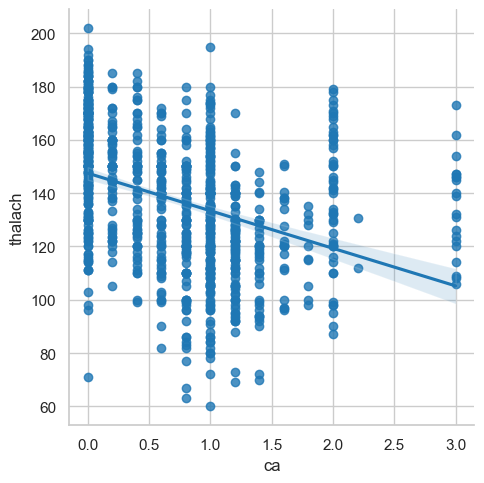

In [39]:
sns.lmplot(y="thalach", x="ca", data=data_imputed);
plt.show()

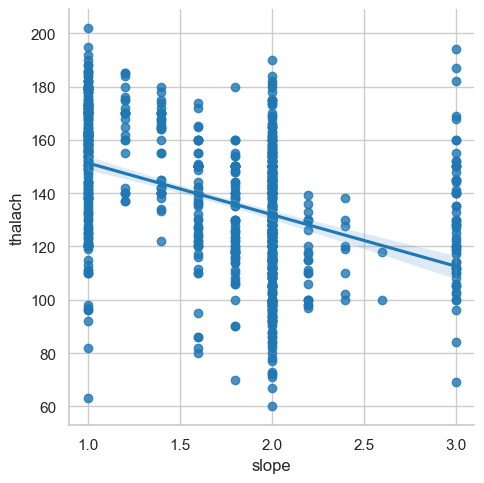

In [40]:
sns.lmplot(y="thalach", x="slope", data=data_imputed);
plt.show()

We can see a high correlation between 'thalach' with most of the other features. All in all it seems like the features in the bottom, right corner are highly correlated. We might consider dropping 'thalach' before performing ML. The high correlation between 'age' and 'age_group' is obvious, but will not be of any relevance for later ML, since that variable will be dropped. For now, it just helps us analyze the data.

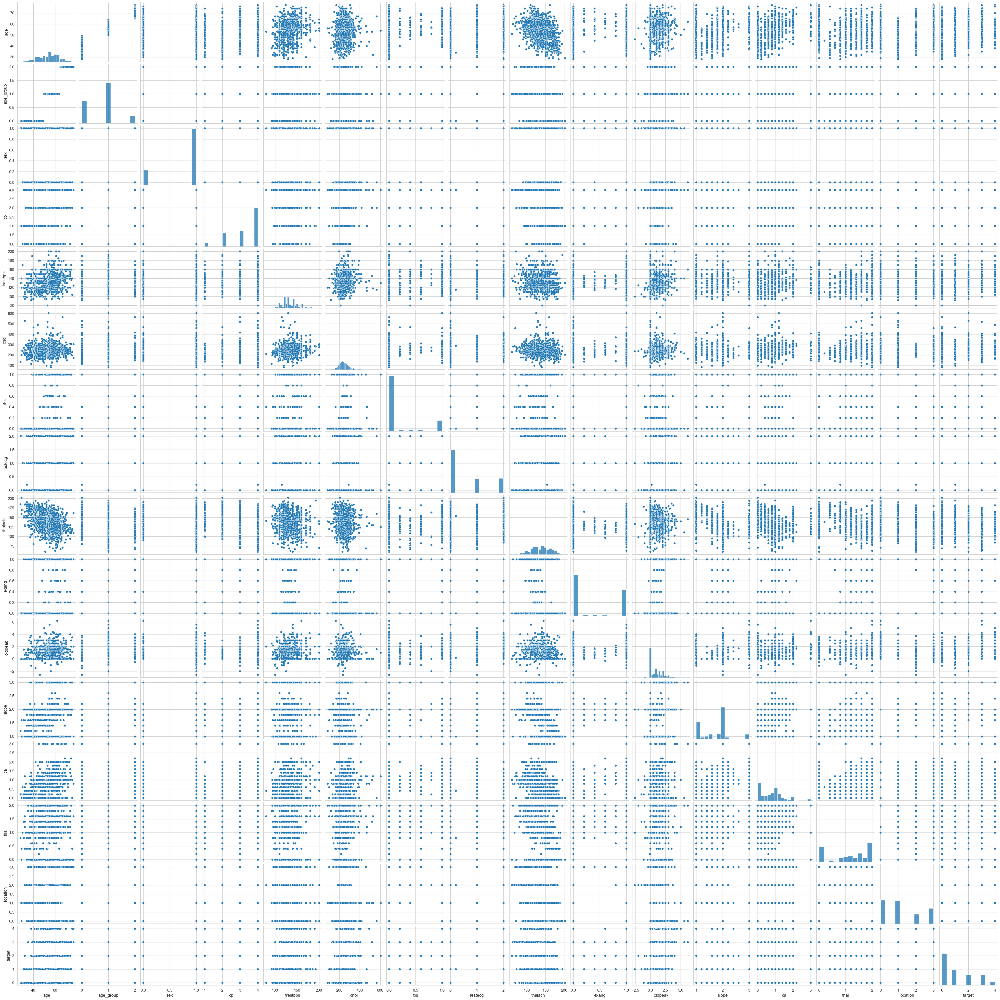

In [41]:
sns.pairplot(data_imputed)
plt.show()

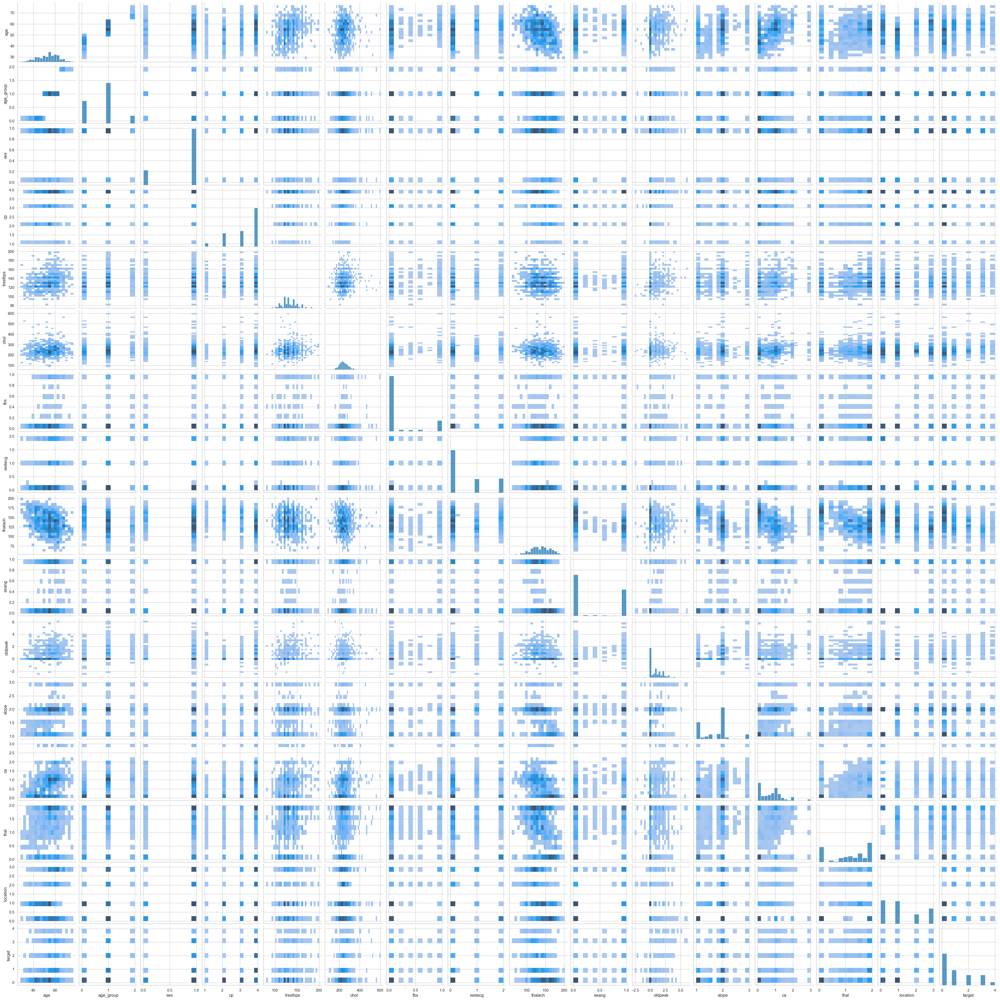

In [42]:
sns.pairplot(data_imputed, kind='hist')
plt.show()

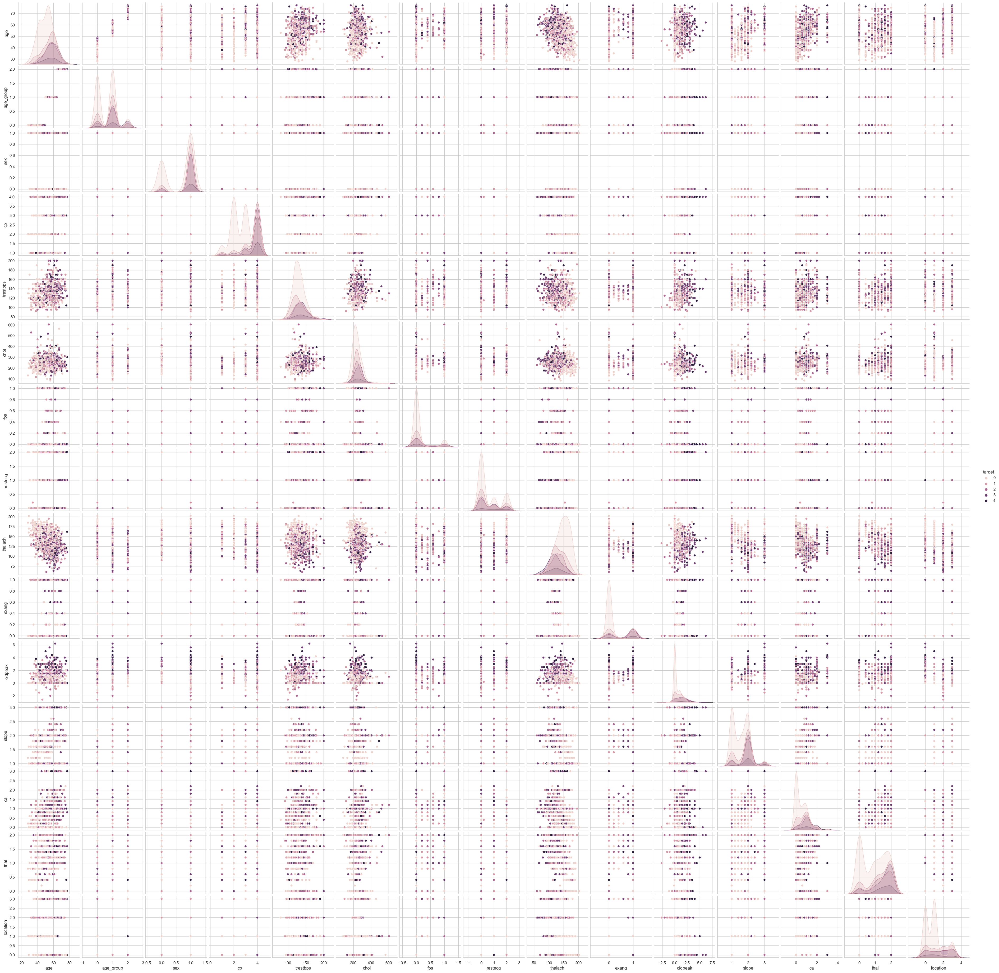

In [43]:
sns.pairplot(data_imputed, hue='target')
plt.show()

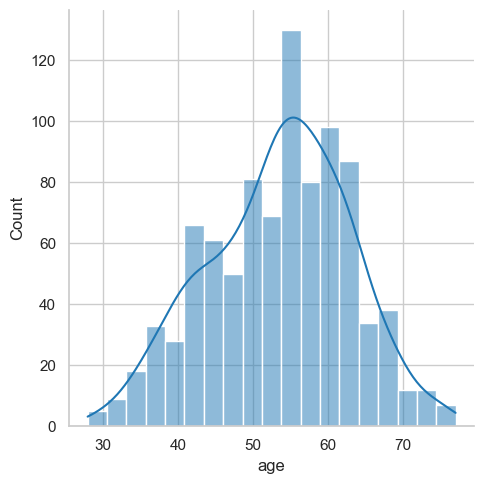

In [44]:
sns.displot(data=data_imputed, x='age', kde=True)
plt.show()

The age is approximately normal distributed with mu=55 and sigma=10.

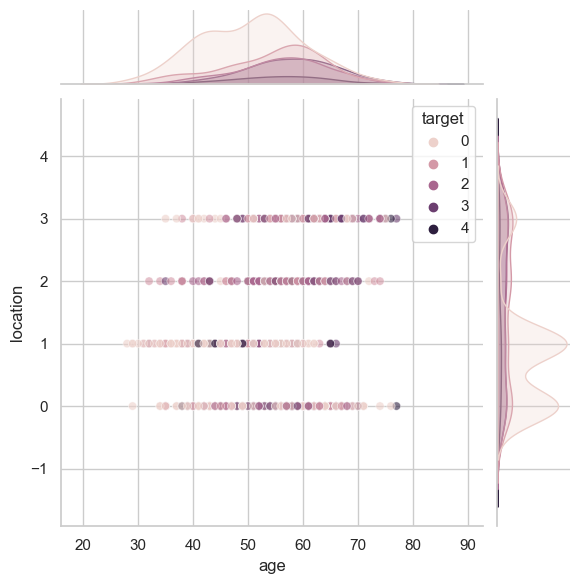

In [45]:
sns.jointplot(data=data_imputed, x='age', y='location', hue='target', alpha=0.6)
plt.show()

The healthy patients seem to mainly be in the Hungarian and Cleveland data set and are aged under 60.

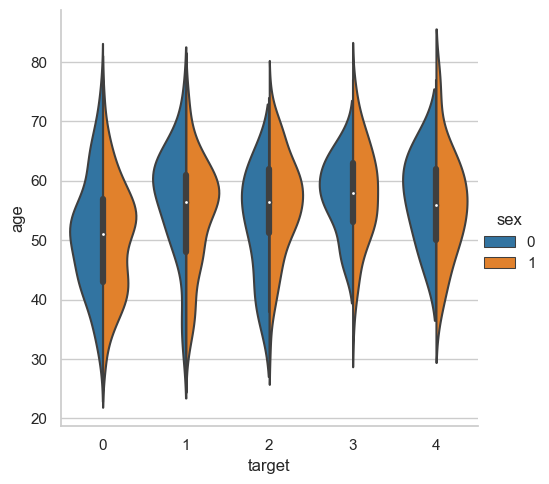

In [46]:
sns.catplot(data=data_imputed, kind='violin', x='target', y='age', hue='sex', split=True)
plt.show()

There seems to be a shift in age, when the diagnosis is stronger.

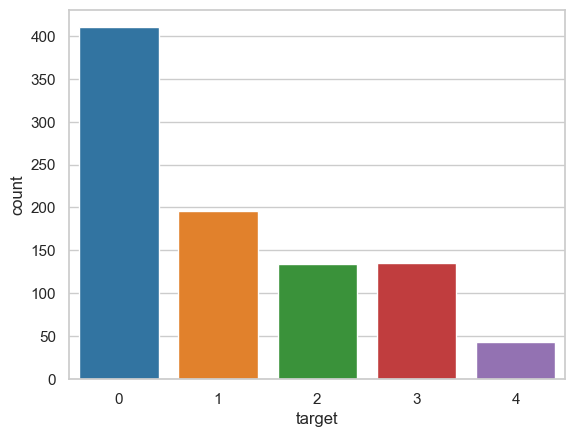

In [47]:
sns.countplot(data=data_imputed, x='target')
plt.show()

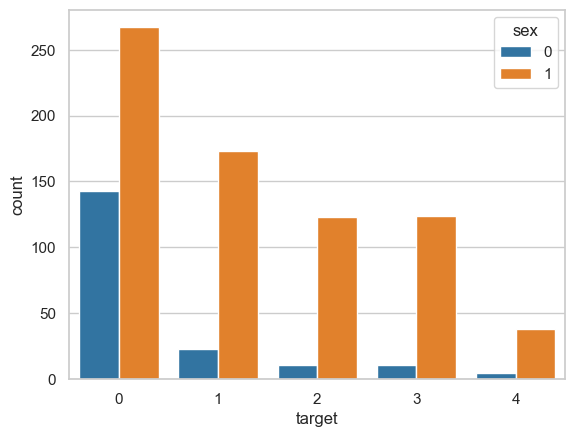

In [48]:
sns.countplot(data=data_imputed, x='target', hue='sex')
plt.show()

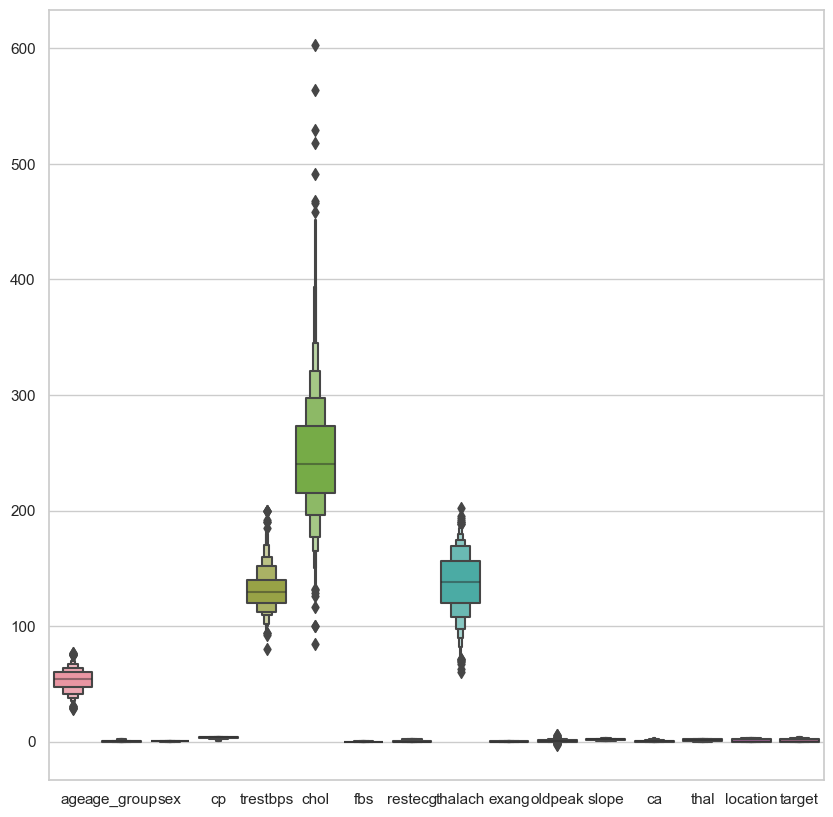

In [49]:
plt.figure(figsize=(10,10))
sns.boxenplot(data=data_imputed)
plt.show()

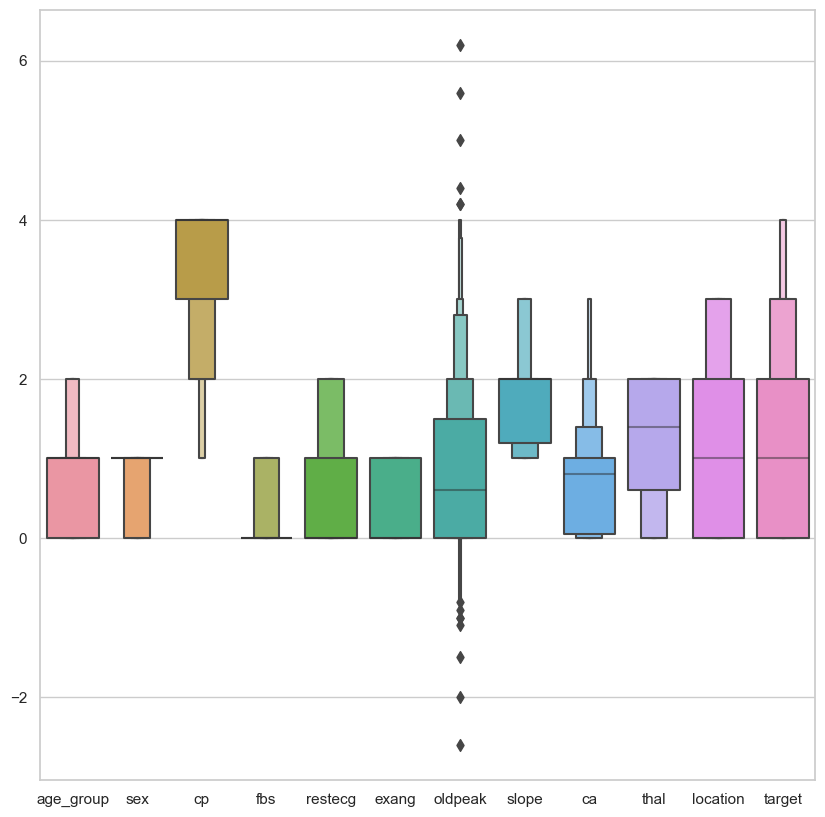

In [50]:
plt.figure(figsize=(10,10))
sns.boxenplot(data=data_imputed.drop(['age', 'thalach', 'trestbps', 'chol'], axis=1))
plt.show()

'sex' and 'fbs' are very biased.

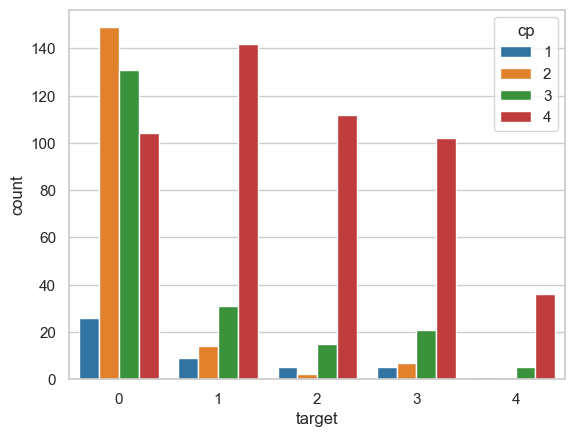

In [51]:
sns.countplot(data=data_imputed, x='target', hue='cp')
plt.show()

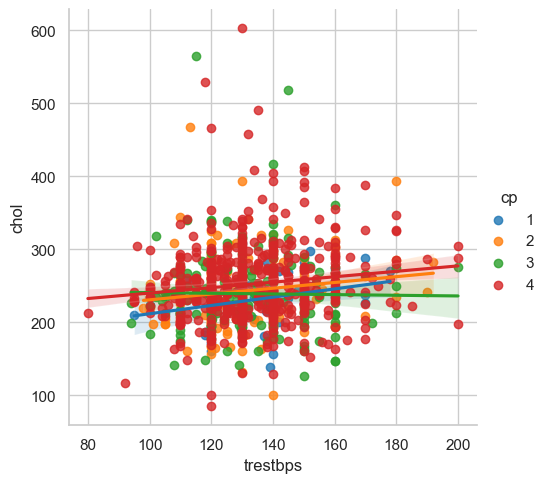

In [52]:
sns.lmplot(x="trestbps", y="chol",data=data_imputed,hue="cp")
plt.show()

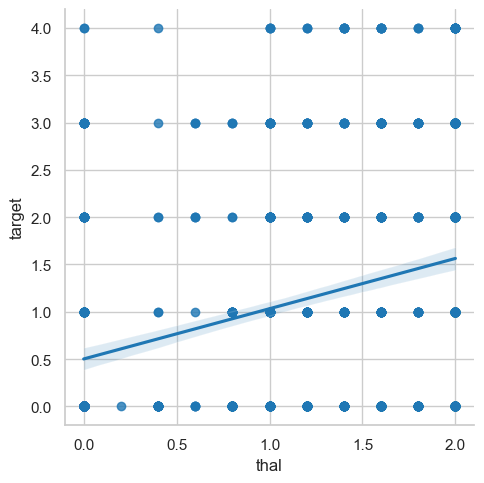

In [53]:
sns.lmplot(x="thal", y="target",data=data_imputed)
plt.show()

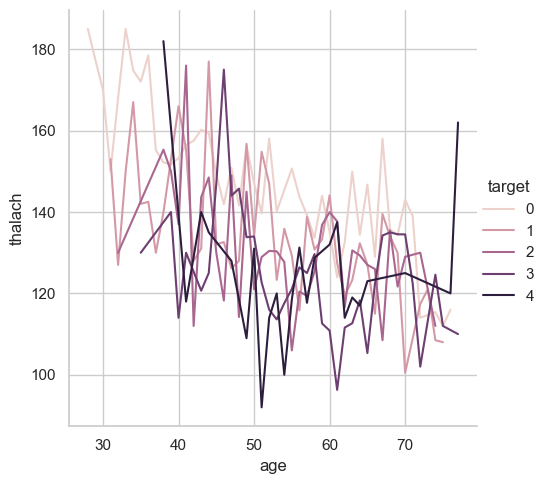

In [54]:
mean_thalach = (data_imputed.groupby(['age', 'target']).mean())[['thalach']]
sns.relplot(x='age', y='thalach', data=mean_thalach, hue='target', kind='line')
plt.show()

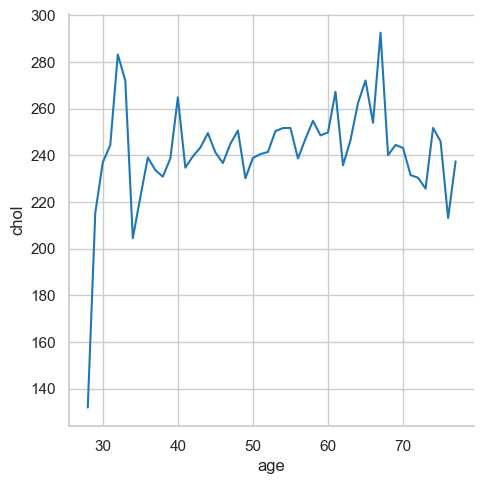

In [55]:
mean_chol = (data_imputed.groupby(['age']).mean())[['chol']]
sns.relplot(x='age', y='chol', data=mean_chol, kind='line')
plt.show()

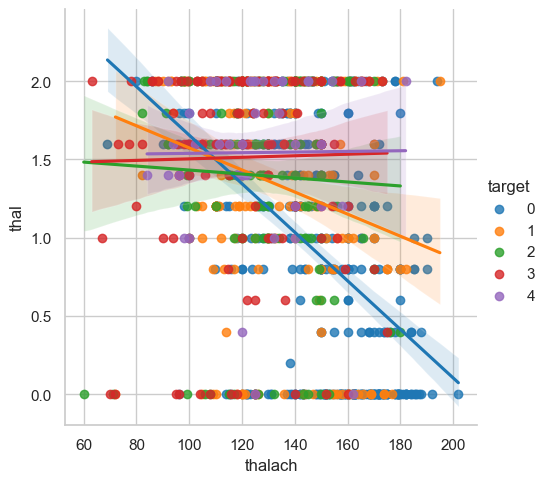

In [56]:
sns.lmplot(y="thal", x="thalach", data=data_imputed, hue='target');
plt.show()

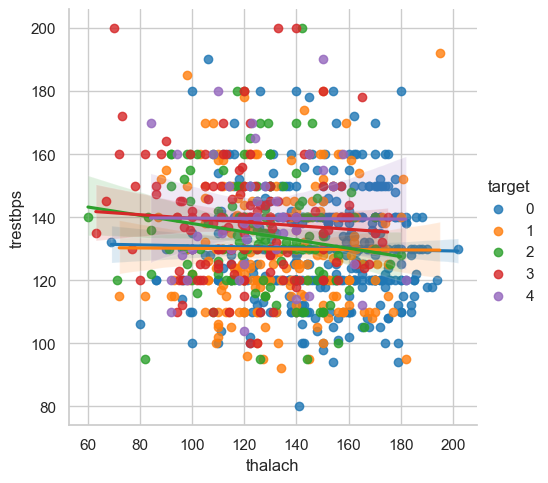

In [57]:
sns.lmplot(y="trestbps", x="thalach", data=data_imputed, hue='target');
plt.show()

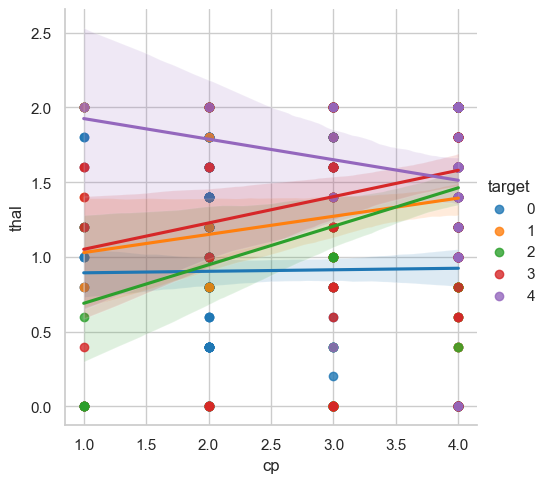

In [58]:
sns.lmplot(y="thal", x="cp", data=data_imputed, hue='target');
plt.show()

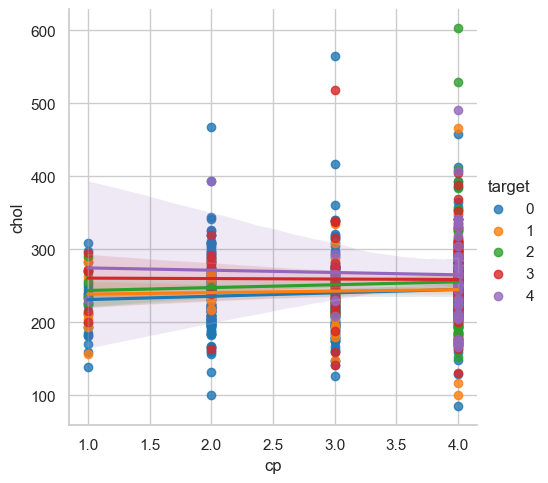

In [59]:
sns.lmplot(y="chol", x="cp", data=data_imputed, hue='target');
plt.show()

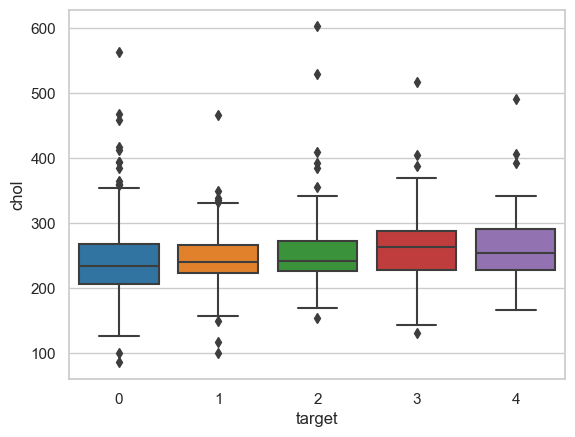

In [60]:
sns.boxplot(data=data_imputed, x='target', y='chol')
plt.show()

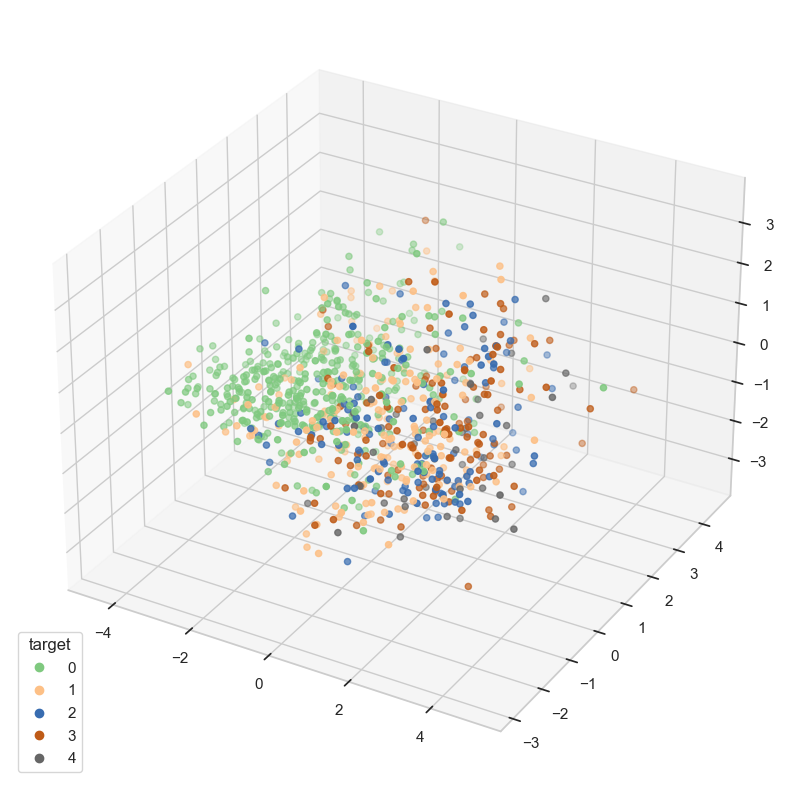

In [61]:
scaler = StandardScaler()
scaled = scaler.fit_transform(data_imputed.drop(['target', 'age_group'], axis=1))

pca = PCA(n_components=3)
projected = pca.fit_transform(scaled)
pc_df = pd.DataFrame(data=projected,
        columns=['PC1', 'PC2', 'PC3'])
pc_df['target'] = data_imputed['target'].reset_index(drop=True)

fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(projection='3d')
scatter = ax.scatter(pc_df.PC1.to_numpy(), pc_df.PC2.to_numpy(), pc_df.PC3.to_numpy(), c=pc_df.target.to_numpy(), cmap='Accent')
legend1 = ax.legend(*scatter.legend_elements(), loc="lower left", title="target")
plt.show()

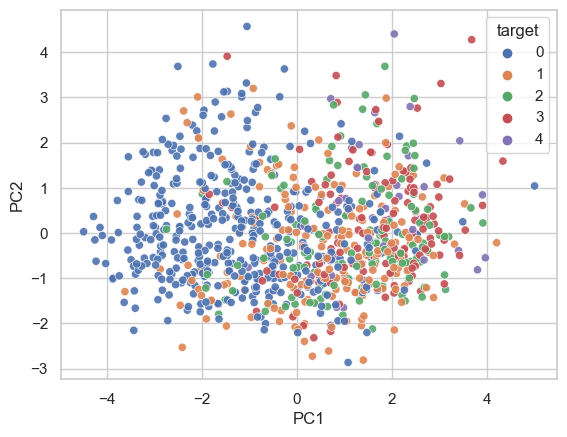

In [62]:
pca = PCA(n_components=2)
projected = pca.fit_transform(scaled)
pc_df = pd.DataFrame(data=projected,
        columns=['PC1', 'PC2'])
pc_df['target'] = data_imputed['target'].reset_index(drop=True)

sns.scatterplot(x=pc_df.PC1, y=pc_df.PC2, hue=pc_df.target, palette='deep', alpha=0.9)
#sns.lmplot(x='PC1', y='PC2', z='PC3', data=pc_df, fit_reg=False, hue='target', legend=True, scatter_kws={"s": 80})
plt.show()

### Subgroups
#### Location

In [63]:
data_imputed.groupby('location').size()

location
0    303
1    293
2    123
3    199
dtype: int64

In [64]:
data_imputed.groupby('location').describe()

age                                                    age_group  \
          count       mean       std   min   25%   50%   75%   max     count   
location                                                                       
0         303.0  54.438944  9.038662  29.0  48.0  56.0  61.0  77.0     303.0   
1         293.0  47.822526  7.824875  28.0  42.0  49.0  54.0  66.0     293.0   
2         123.0  55.317073  9.032108  32.0  51.0  56.0  61.5  74.0     123.0   
3         199.0  59.356784  7.830808  35.0  55.0  60.0  64.0  77.0     199.0   

                    ... thal      target                                     \
              mean  ...  75%  max  count      mean       std  min  25%  50%   
location            ...                                                       
0         0.848185  ...  2.0  2.0  303.0  0.937294  1.228536  0.0  0.0  0.0   
1         0.467577  ...  1.8  2.0  293.0  0.795222  1.238251  0.0  0.0  0.0   
2         0.926829  ...  2.0  2.0  123.0  1.804878  1.013503  0.0  1.0  2.0   
3         1.115578  ...  2.0  2.0  199.0  1.517588  1.222038  0.0  0.0  1.0   

                    
          75%  max  
location            
0         2.0  4.0  
1         1.0  4.0  
2         3.0  4.0  
3         3.0  4.0  

[4 rows x 120 columns]

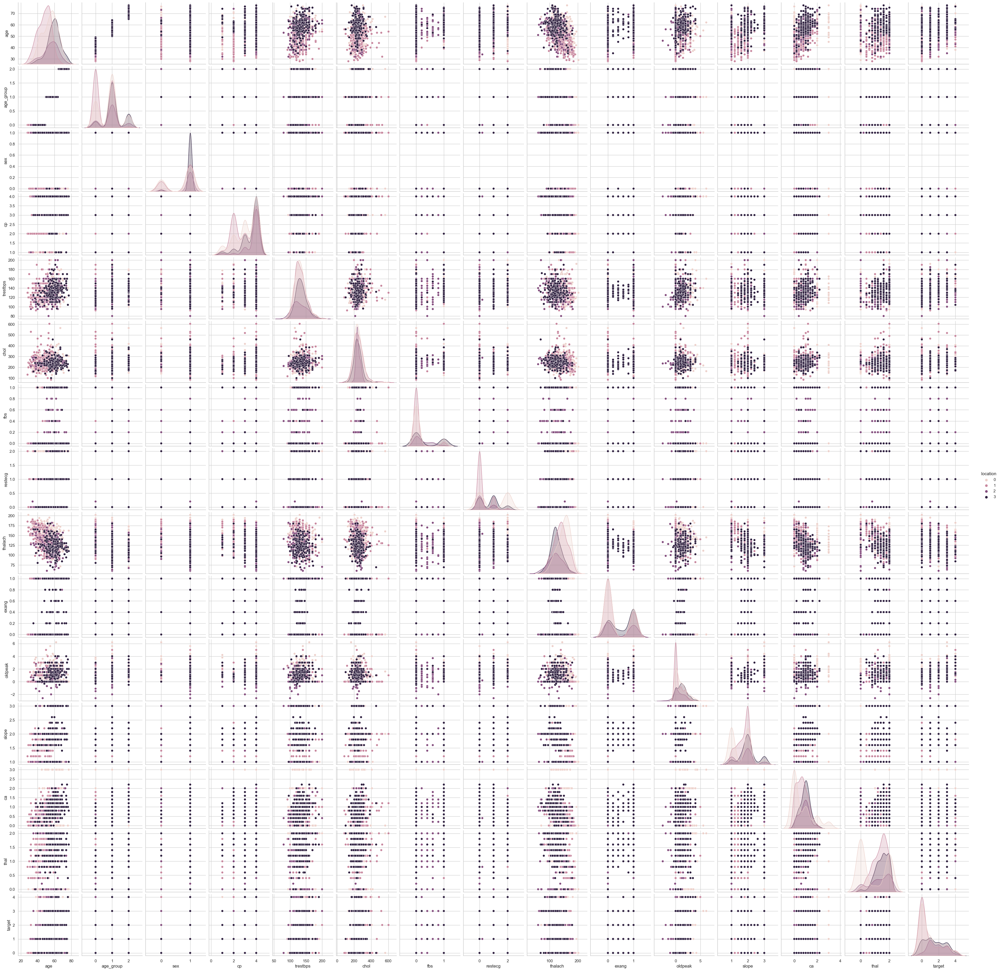

In [65]:
sns.pairplot(data_imputed, hue='location')
plt.show()

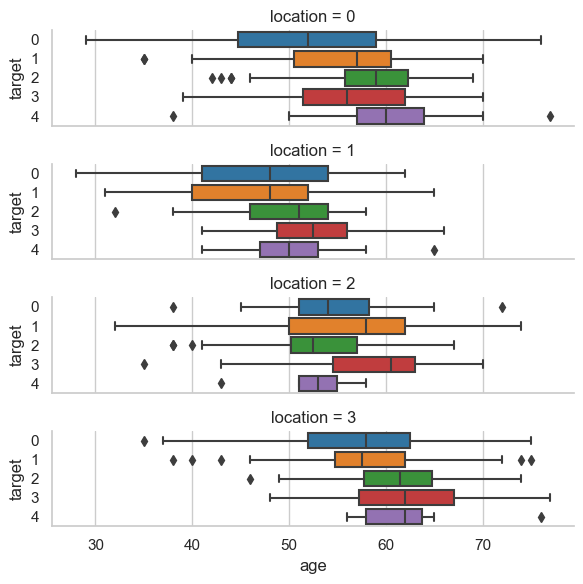

In [66]:
sns.catplot(x="age", y="target", row="location",
                kind="box", orient="h", height=1.5, aspect=4,
                data=data_imputed)
plt.show()

We can see that in the Hungarian data set the median of the patients is younger than in the other data sets.

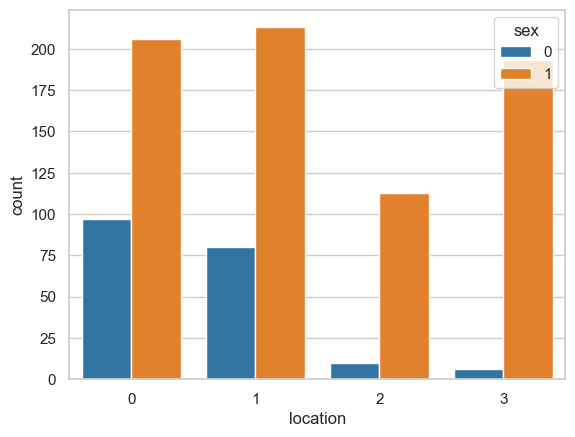

In [67]:
sns.countplot(data=data_imputed, x='location', hue='sex')
plt.show()

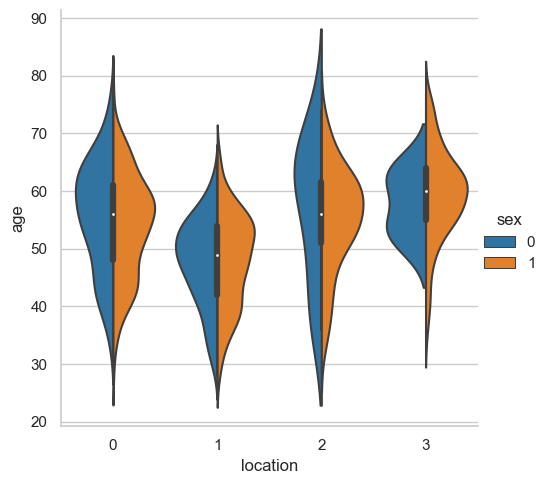

In [68]:
sns.catplot(data=data_imputed, kind='violin', x='location', y='age', hue='sex', split=True)
plt.show()

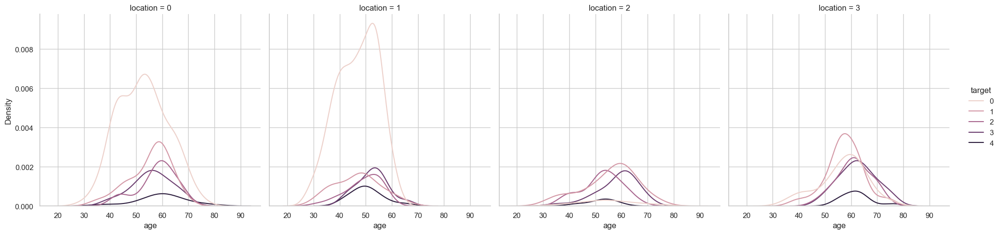

In [69]:
sns.displot(data=data_imputed, x='age', hue='target', col='location', kind="kde")
plt.show()

The Switzerland and VA data set are evened out when it comes to the distribution of the single targets.

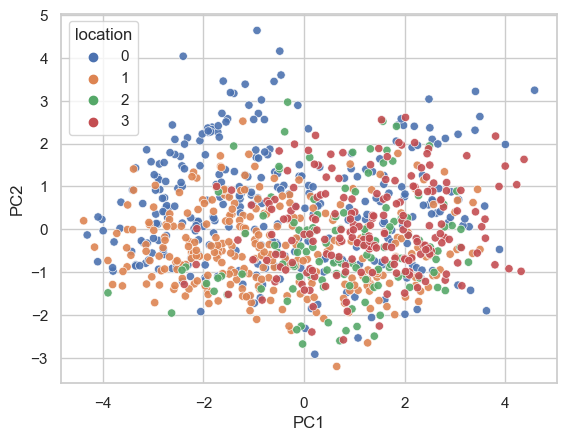

In [70]:
scaler4 = StandardScaler()
scaled4 = scaler4.fit_transform(data_imputed.drop(['location', 'age_group'], axis=1))


pca = PCA(n_components=2)
projected = pca.fit_transform(scaled4)
pc_df = pd.DataFrame(data=projected,
        columns=['PC1', 'PC2'])
pc_df['location'] = data_imputed['location'].reset_index(drop=True)

sns.scatterplot(x=pc_df.PC1, y=pc_df.PC2, hue=pc_df.location, palette='deep', alpha=0.9)
#sns.lmplot(x='PC1', y='PC2', z='PC3', data=pc_df, fit_reg=False, hue='target', legend=True, scatter_kws={"s": 80})
plt.show()

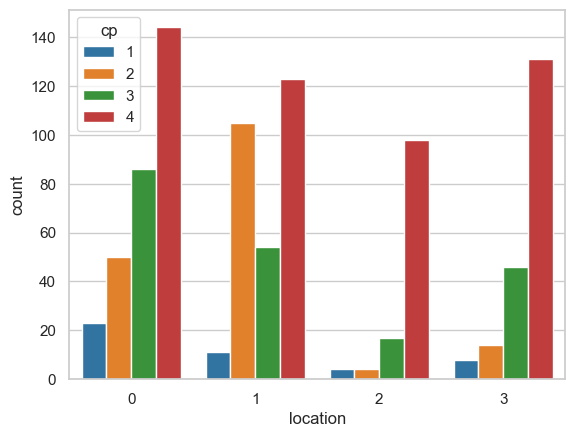

In [71]:
sns.countplot(data=data_imputed, x='location', hue='cp')
plt.show()

#### Age group

In [72]:
data_imputed.groupby('age_group').size()

age_group
0    291
1    524
2    103
dtype: int64

In [73]:
data_imputed.groupby('age_group').describe()

age                                                       sex  \
           count       mean       std   min   25%   50%   75%   max  count   
age_group                                                                    
0          291.0  42.350515  4.887086  28.0  39.0  43.0  46.0  49.0  291.0   
1          524.0  56.753817  4.041194  50.0  54.0  57.0  60.0  64.0  524.0   
2          103.0  68.543689  3.268317  65.0  66.0  68.0  70.0  77.0  103.0   

                     ... location      target                                \
               mean  ...      75%  max  count      mean       std  min  25%   
age_group            ...                                                      
0          0.756014  ...      1.0  3.0  291.0  0.711340  1.095056  0.0  0.0   
1          0.803435  ...      3.0  3.0  524.0  1.274809  1.267650  0.0  0.0   
2          0.815534  ...      3.0  3.0  103.0  1.611650  1.330141  0.0  0.0   

                          
           50%  75%  max  
age_group                 
0          0.0  1.0  4.0  
1          1.0  2.0  4.0  
2          2.0  3.0  4.0  

[3 rows x 120 columns]

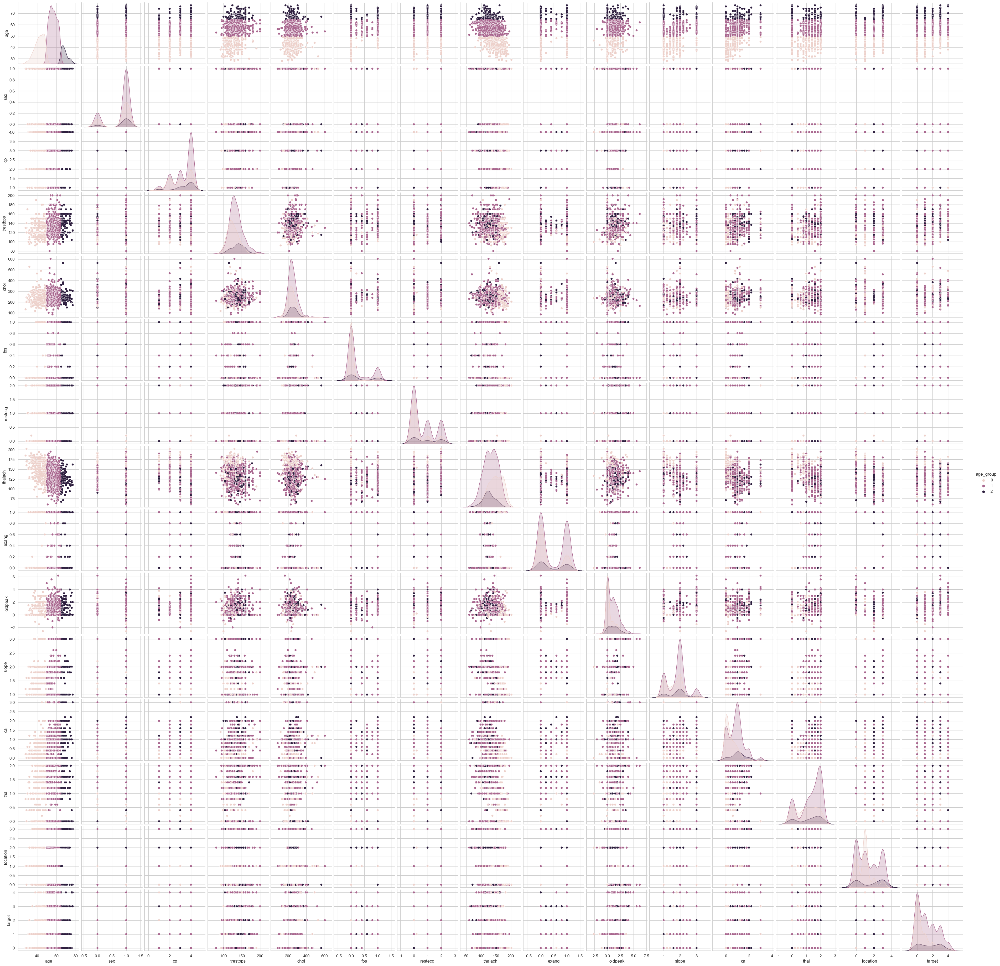

In [74]:
sns.pairplot(data_imputed, hue='age_group')
plt.show()

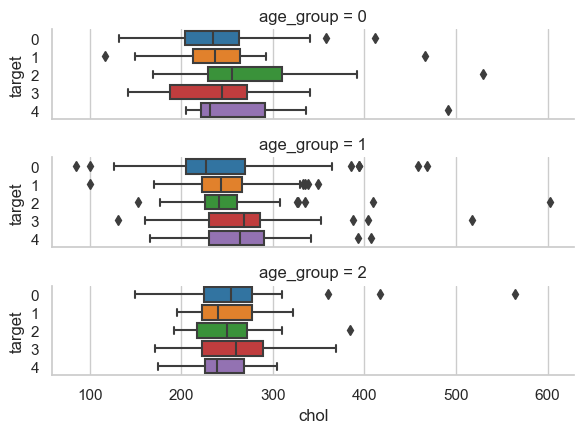

In [75]:
sns.catplot(x="chol", y="target", row="age_group",
                kind="box", orient="h", height=1.5, aspect=4,
                data=data_imputed)
plt.show()

In the middle age group there are more outliers than in the other groups

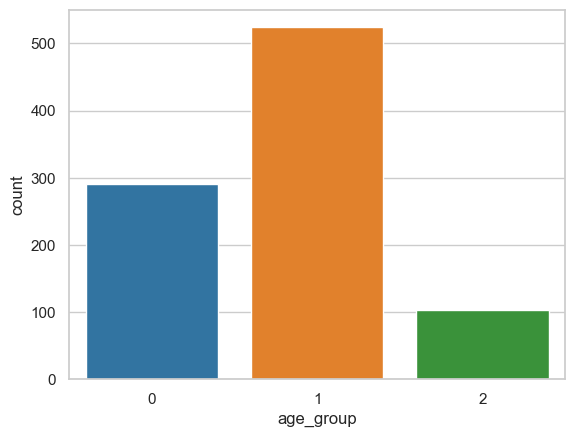

In [76]:
sns.countplot(data=data_imputed, x='age_group')
plt.show()

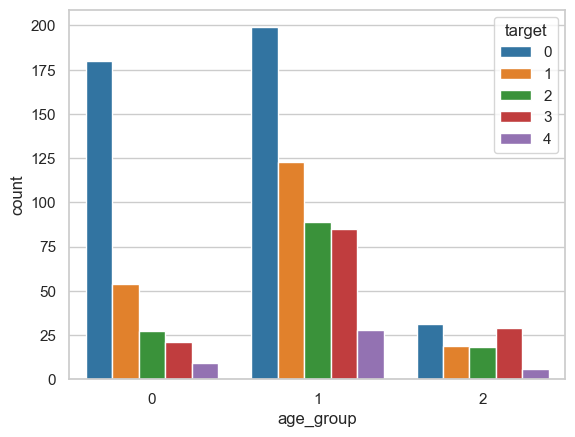

In [77]:
sns.countplot(data=data_imputed, x='age_group', hue='target')
plt.show()

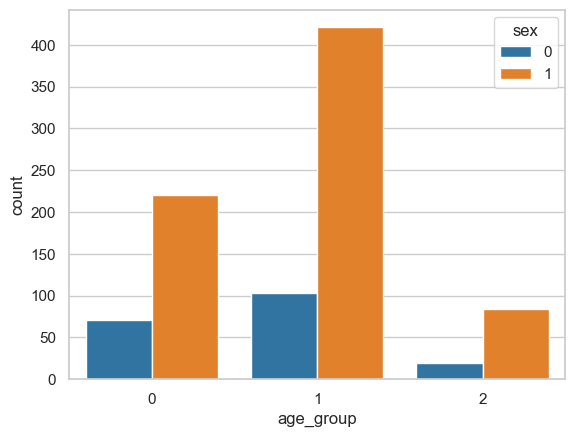

In [78]:
sns.countplot(data=data_imputed, x='age_group', hue='sex')
plt.show()

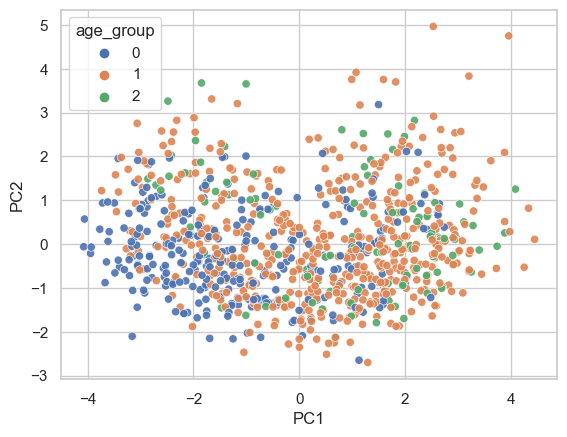

In [79]:
scaler3 = StandardScaler()
scaled3 = scaler3.fit_transform(data_imputed.drop(['age_group', 'age'], axis=1))


pca = PCA(n_components=2)
projected = pca.fit_transform(scaled3)
pc_df = pd.DataFrame(data=projected,
        columns=['PC1', 'PC2'])
pc_df['age_group'] = data_imputed['age_group'].reset_index(drop=True)

sns.scatterplot(x=pc_df.PC1, y=pc_df.PC2, hue=pc_df.age_group, palette='deep', alpha=0.9)
#sns.lmplot(x='PC1', y='PC2', z='PC3', data=pc_df, fit_reg=False, hue='target', legend=True, scatter_kws={"s": 80})
plt.show()

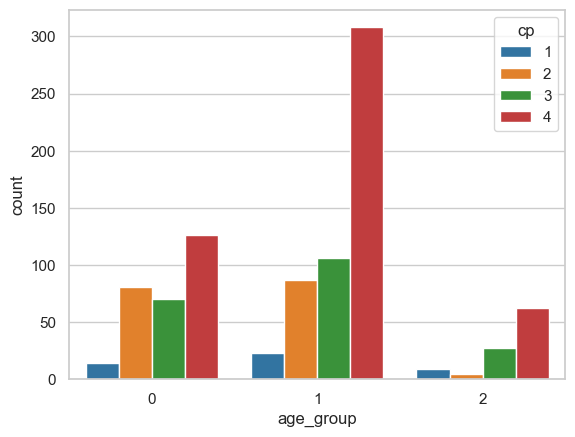

In [80]:
sns.countplot(data=data_imputed, x='age_group', hue='cp')
plt.show()

#### Sex

In [81]:
data_imputed.groupby('sex').size()

sex
0    193
1    725
dtype: int64

In [82]:
data_imputed.groupby('sex').describe()

age                                                    age_group  \
     count       mean       std   min   25%   50%   75%   max     count   
sex                                                                       
0    193.0  52.492228  9.517593  30.0  46.0  53.0  60.0  76.0     193.0   
1    725.0  53.782069  9.397864  28.0  47.0  55.0  60.0  77.0     725.0   

               ... location      target                                     \
         mean  ...      75%  max  count      mean       std  min  25%  50%   
sex            ...                                                           
0    0.730570  ...      1.0  3.0  193.0  0.507772  1.010977  0.0  0.0  0.0   
1    0.812414  ...      3.0  3.0  725.0  1.300690  1.267120  0.0  0.0  1.0   

               
     75%  max  
sex            
0    1.0  4.0  
1    2.0  4.0  

[2 rows x 120 columns]

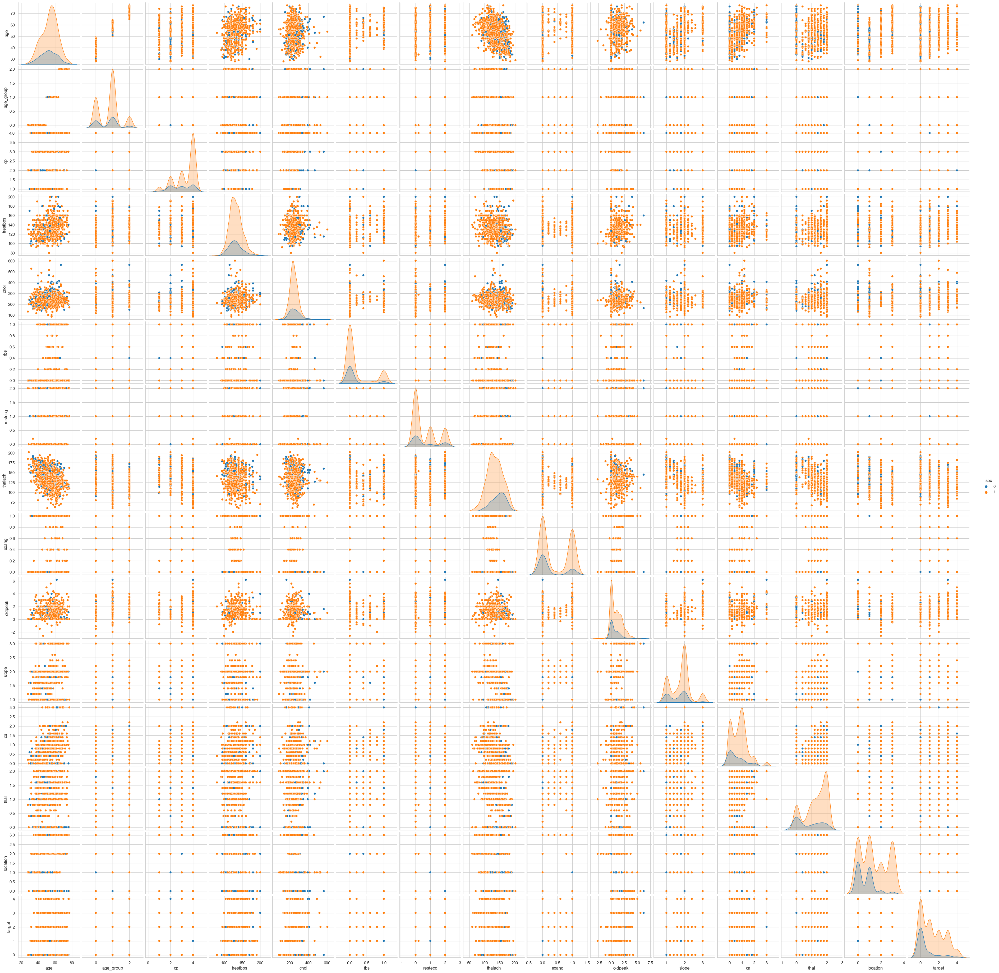

In [83]:
sns.pairplot(data_imputed, hue='sex')
plt.show()

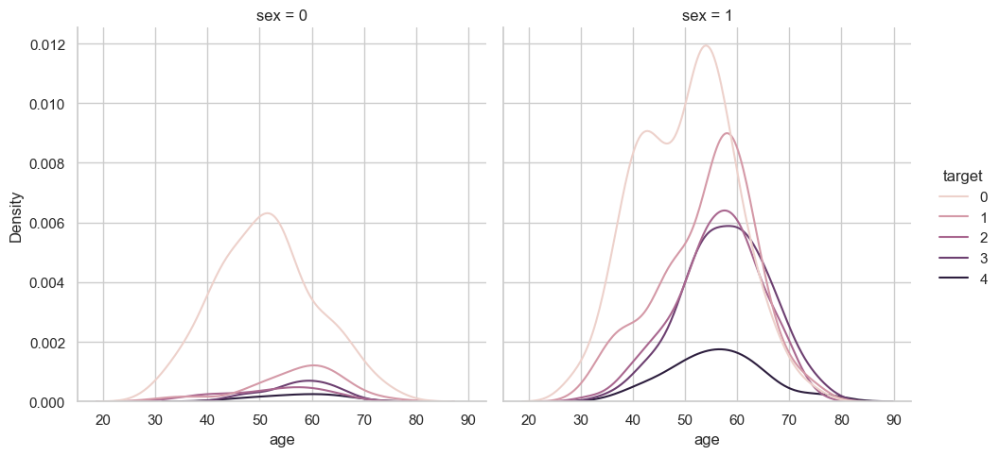

In [84]:
sns.displot(data=data_imputed, x='age', hue='target', col='sex', kind="kde")
plt.show()

There only seems to be a small size of female patients with a diagnosis.

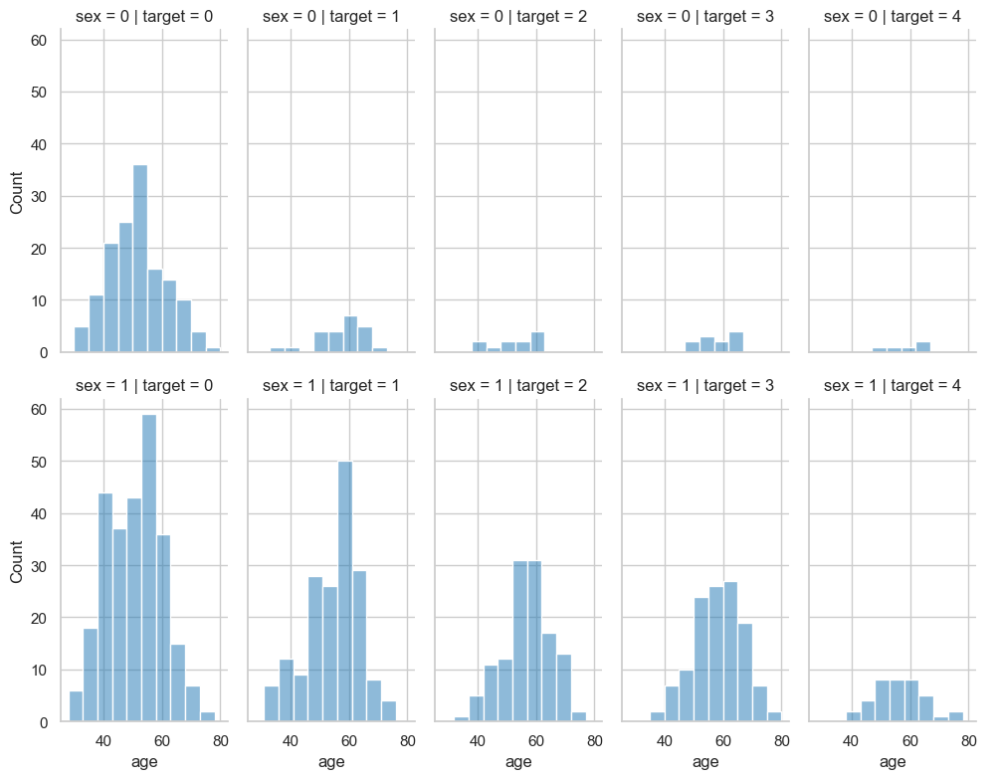

In [85]:
# more or less the same as above
sns.set_context('notebook', font_scale=1)
g = sns.FacetGrid(data_imputed, col='target', height=4, aspect=.5, row='sex')
g.map(sns.histplot, "age", binwidth=5, alpha=0.5)
g.add_legend()
plt.show()

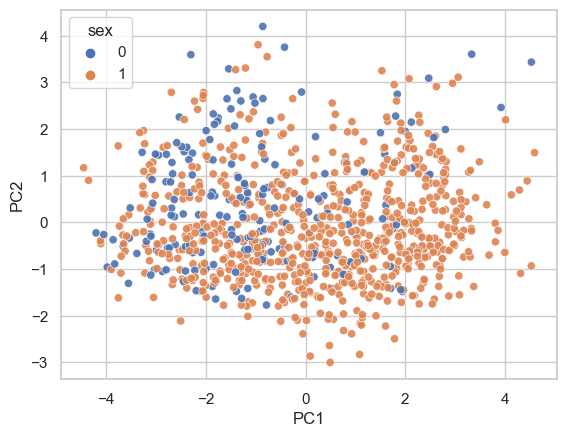

In [86]:
scaler2 = StandardScaler()
scaled2 = scaler2.fit_transform(data_imputed.drop(['sex', 'age_group'], axis=1))


pca = PCA(n_components=2)
projected = pca.fit_transform(scaled2)
pc_df = pd.DataFrame(data=projected,
        columns=['PC1', 'PC2'])
pc_df['sex'] = data_imputed['sex'].reset_index(drop=True)

sns.scatterplot(x=pc_df.PC1, y=pc_df.PC2, hue=pc_df.sex, palette='deep', alpha=0.9)
#sns.lmplot(x='PC1', y='PC2', z='PC3', data=pc_df, fit_reg=False, hue='target', legend=True, scatter_kws={"s": 80})
plt.show()

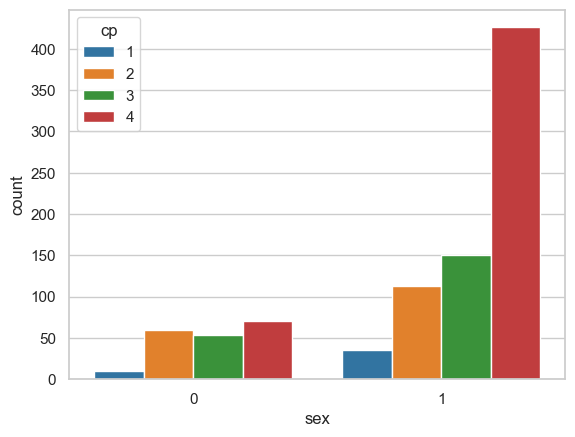

In [87]:
sns.countplot(data=data_imputed, x='sex', hue='cp')
plt.show()